(mmm_case_study)=
# MMM End-to-End Case Study for Pluto TV 2024

This case study is based on [PyData Global 2022](https://pydata.org/global2022/) presentation ([Hajime Takeda - Media Mix Modeling:How to Measure the Effectiveness of Advertising](https://www.youtube.com/watch?v=u4U_PUTasPQ)). The notebook for the original case study can be found in `mmm_case_study.ipynb`. Our goal is to show how MMM can help marketing teams:

1. Quantify the impact of different marketing channels on sales
2. Understand saturation effects and diminishing returns
3. Identify opportunities to reallocate budget for improved performance
4. Make data-driven decisions about future marketing investments

**Outline**

1. Data Preparation and Exploratory Analysis
2. Model Specification and Fitting
3. Model Diagnostics and Validation  
4. Marketing Channel Deep Dive
   - Channel Contributions
   - Saturation Curves
   - Return on Ad Spend (ROAS)
5. Out-of-Sample Predictions
6. Budget Optimization
7. Key Takeaways and Next Steps

```{note}
In this notebook we guide you through what a typical MMM first iteration looks like (note that what a first iteration means depends on the business context). We focus on the application of the model for a concrete business case. If you want to know more about the model specification please refer to the {ref}`mmm_example` notebook.
```


## Prepare Notebook

We load the necessary libraries and set the notebook's configuration.

In [181]:
import warnings

import arviz as az
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
import logging
import numpyro
import pprint
from itertools import combinations

from pymc_marketing.metrics import crps

from pymc_marketing.mmm import MMM, GeometricAdstock, LogisticSaturation, HillSaturation, DelayedAdstock
from pymc_marketing.mmm.utils import apply_sklearn_transformer_across_dim
from pymc_marketing.prior import Prior

warnings.filterwarnings("ignore", category=FutureWarning)

az.style.use("arviz-darkgrid")
plt.rcParams["figure.figsize"] = [15, 7]
plt.rcParams["figure.dpi"] = 100\

%load_ext autoreload
%autoreload 2
%config InlineBackend.figure_format = "retina"

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [182]:
seed: int = sum(map(ord, "mmm"))
rng: np.random.Generator = np.random.default_rng(seed=seed)

## Load Data

We load the data from a CSV file as a pandas DataFrame. We also do some light data cleaning following the filtering of the original case study. In essence, we are filtering and renaming certain marketing channels.

In [183]:
raw_df = pd.read_csv("/Users/shua0225/MMM/mmm_data_wide_042425.csv")
# Ensure 'day_dt' is in datetime format
raw_df["day_dt"] = pd.to_datetime(raw_df["day_dt"], errors="coerce")
raw_df.columns

Index(['day_dt', 'channel_app_imps', 'channel_hmi_audio_imps',
       'channel_hmi_display_imps', 'channel_hmi_linear_imps',
       'channel_hmi_ooh_imps', 'channel_hmi_video_imps',
       'channel_influencer_imps', 'channel_macs_programmatic_imps',
       'channel_macs_social_imps', 'channel_oo_display_imps',
       'channel_oo_linear_imps', 'channel_oo_video_imps',
       'channel_paid_search_imps', 'channel_partnerships_imps',
       'channel_podcast_one_imps', 'channel_app_spend',
       'channel_hmi_audio_spend', 'channel_hmi_display_spend',
       'channel_hmi_linear_spend', 'channel_hmi_ooh_spend',
       'channel_hmi_video_spend', 'channel_influencer_spend',
       'channel_macs_programmatic_spend', 'channel_macs_social_spend',
       'channel_oo_display_spend', 'channel_oo_linear_spend',
       'channel_oo_video_spend', 'channel_paid_search_spend',
       'channel_partnerships_spend', 'channel_podcast_one_spend',
       'y_returning', 'y_new_winback', 'y_total_qdau', 'weekday_

Add holidays as a control variable

In [ ]:

# Map the event dictionary of notable events
events_dict = {
    "2023-01-01": "ny23_2023",
    "2023-01-16": "mlk_2023",
    "2023-02-20": "pres_2023",
    "2023-03-24": "anomaly_3_24_23",
    "2023-03-25": "anomaly_3_25_23",
    "2023-03-26": "anomaly_3_26_23",
    "2023-03-27": "anomaly_3_27_23",
    "2023-03-28": "anomaly_3_28_23",
    "2023-05-29": "mem_2023",
    "2023-06-19": "juneteenth_2023",
    "2023-07-04": "ind_2023",
    "2023-09-04": "lab_2023",
    
    "2023-11-23": "thanks_2023",
    
    "2023-11-24": "blk_fri_2023",
    "2023-12-17": "anomaly_12_17_23",
    "2023-12-23": "day_b4_xmas_eve_2023",
    "2023-12-24": "xmas_eve_2023",
    "2023-12-25": "xmas_2023",
    "2023-12-26": "xmas_day_after_2023",
    "2023-12-30": "day_b4_nye_2023",
    "2023-12-31": "nye_2023",
    "2024-01-01": "ny24_2024",
    "2024-01-15": "mlk_2024",
    "2024-02-11": "anomaly_2_11_2024",
    "2024-02-19": "pres_2024",
    "2024-03-14": "anomaly_3_14_2024",
    "2024-05-27": "mem_2024",
    "2024-06-19": "juneteenth_2024",
    "2024-07-04": "ind_2024",
    "2024-09-02": "lab_2024",
    "2024-11-28": "thanks_2024",
    "2024-11-29": "blk_fri_2024",
    "2024-12-24": "xmas_eve_2024",
    "2024-12-25": "xmas_2024",
    "2024-12-31": "nye_2024",
    "2023-02-12": "superbowl_2023",
    "2024-02-11": "superbowl_2024",
}



# Map the event names to the 'event' column
raw_df['event'] = pd.to_datetime(raw_df['day_dt'], errors='coerce').dt.strftime('%Y-%m-%d').map(events_dict)


In [ ]:
def identify_anomaly_zscore(df, column_name, date_column, threshold=3.0):
    """
    Identify anomalous values based on z-score.

    Parameters:
        df (pd.DataFrame): Input dataframe
        column_name (str): Column to calculate z-score
        date_column (str): Column that holds date information
        threshold (float): Z-score threshold to define anomaly (default 3.0)

    Returns:
        pd.DataFrame: Dataframe with date, column value, and z-score
    """
    # Calculate mean and standard deviation
    mean = df[column_name].mean()
    std = df[column_name].std()

    # Calculate z-scores
    df['z_score'] = (df[column_name] - mean) / std

    # Filter anomalies
    anomalies = df[df['z_score'].abs() >= threshold]

    # Select required columns
    result = anomalies[[date_column, column_name, 'z_score']].copy()
    
    return result

# Identify anomalies in the 'y' column
identify_anomaly_zscore(raw_df, 'y_returning', 'day_dt', threshold=2)

,day_dt,y_returning,z_score
1,2024-01-01,3701522,2.523696
2,2023-01-10,3054747,-2.164347
4,2023-01-11,3059227,-2.131874
6,2023-01-12,3068898,-2.061776
12,2023-01-15,3074208,-2.023287
16,2023-01-17,3073045,-2.031717
54,2023-01-06,3065043,-2.089718
58,2023-01-08,3070071,-2.053273
60,2023-01-09,3049002,-2.205989
127,2024-11-10,3657511,2.204690


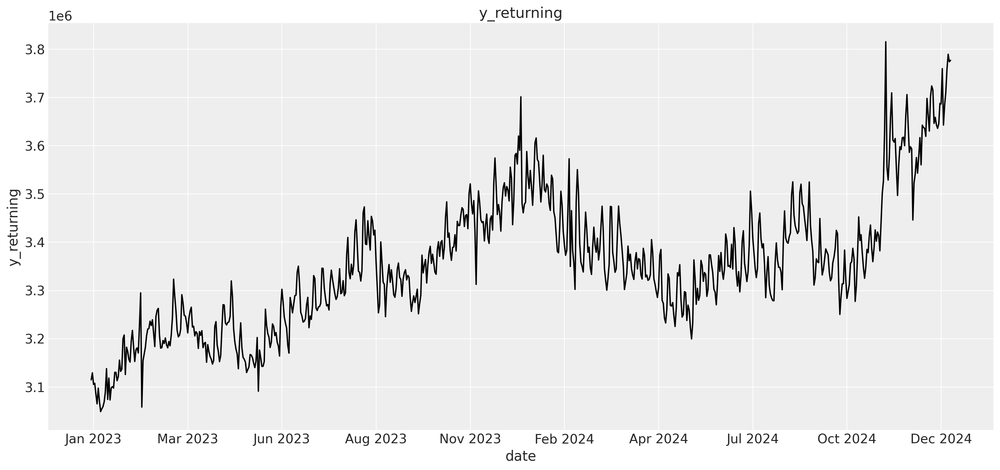

In [188]:
fig, ax = plt.subplots()
sns.lineplot(data=raw_df, x="day_dt", y="y_returning", color="black", ax=ax)
ax.xaxis.set_major_locator(plt.MaxNLocator(nbins=12))
ax.xaxis.set_major_formatter(plt.matplotlib.dates.DateFormatter("%b %Y"))
ax.set(title="y_returning", xlabel="date", ylabel="y_returning");

Roll up by week

In [ ]:
# create a column for week. It should start on Sunday
# and end on Saturday
raw_df["day_dt"] = pd.to_datetime(raw_df["day_dt"], errors="coerce")

# create a week column that starts on Sunday
raw_df['week'] = raw_df['day_dt'].dt.to_period('W-SAT').dt.start_time

# create a list of columns that start with channel
channel_cols = [col for col in raw_df.columns if col.startswith("channel_")]

# create a list of y_vars to aggregate
y_vars = ["y_returning", "y_new_winback"]

event_cols = [col for col in raw_df.columns if col.startswith("event_")]

# cols_to_agg = channel_cols + y_vars + ["event"]
# aggregate the data to weekly
agg_dict = {col: 'sum' for col in cols_to_agg}
# for the event columns, we want 1 if event column is >= 1, else 0
for col in event_cols:
    agg_dict[col] = lambda x: 1 if x.sum() >= 1 else 0


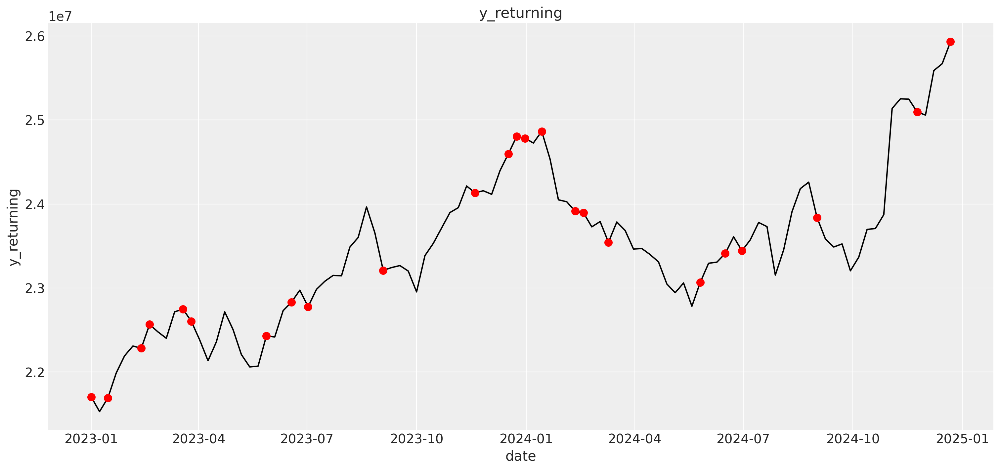

In [190]:
# aggregate the data weekly
weekly_df = raw_df.groupby("week").agg(agg_dict).reset_index()
weekly_df["week"] = pd.to_datetime(weekly_df["week"])

# create one-hot encoding for the event columns
event_dummies = pd.get_dummies(weekly_df["event"], prefix="event_", prefix_sep="")

# convert the event columns to 0 or 1
for col in event_dummies.columns:
    event_dummies[col] = np.where(event_dummies[col] >= 1, 1, 0)


weekly_df = pd.concat([weekly_df, event_dummies], axis=1).drop(columns=["event_0"])


# plot the y_var by week and identify the weeks with anomalies with a red dot
fig, ax = plt.subplots()
sns.lineplot(data=weekly_df.iloc[:-1], x="week", y="y_returning", color="black", ax=ax)
ax.set(title="y_returning", xlabel="date", ylabel="y_returning");
# plot the y_var by week and identify the weeks with anomalies with a red dot
for i, row in weekly_df.iloc[:-1].iterrows():
    if row["event"] != 0:
        ax.plot(row["week"], row["y_returning"], "ro", markersize=8)


If we want to look at a specific year:

In [191]:
# create a linear trend variable and scale it between 0 to 1
#weekly_df['linear_trend'] = (weekly_df['week'] - weekly_df['week'].min()) / (weekly_df['week'].max() - weekly_df['week'].min())
#display(weekly_df)

In [192]:


# 1. control variables
# We just keep the holidays columns
control_columns = [col for col in weekly_df.columns if col.startswith("event_")]
print("Control columns:", control_columns)

# 2. media variables
# Impressions only for now
media_activity = "imps" # must be "imps" or "spend"
channel_columns_raw = sorted(
    [
        col
        for col in weekly_df.columns
        if ("channel_" in col) & (f"_{media_activity}" in col)
    ]
)

imps_channel_mapping = {
    "channel_app_imps": "MACS App",
    "channel_hmi_audio_imps": "HMI Audio",
    "channel_hmi_display_imps": "HMI Display",
    "channel_hmi_linear_imps": "HMI Linear",
    "channel_hmi_ooh_imps": "HMI OOH",
    "channel_hmi_video_imps": "HMI Digital Video",
    "channel_influencer_imps": "Influencer",
    "channel_macs_programmatic_imps": "MACS Programmatic",
    "channel_macs_social_imps": "MACS Social",
    "channel_oo_display_imps": "OO Display",
    "channel_oo_linear_imps": "OO Linear",
    "channel_oo_video_imps": "OO Video",
    "channel_paid_search_imps": "Paid Search",
    "channel_partnerships_imps": "Partnerships",
    "channel_podcast_one_imps": "Podcast One Audio",
}



spend_channel_mapping = {
    "channel_app_spend": "MACS App",
    "channel_hmi_audio_spend": "HMI Audio",
    "channel_hmi_display_spend": "HMI Display",
    "channel_hmi_linear_spend": "HMI Linear",
    "channel_hmi_ooh_spend": "HMI OOH",
    "channel_hmi_video_spend": "HMI Digital Video",
    "channel_influencer_spend": "Influencer",
    "channel_macs_programmatic_spend": "MACS Programmatic",
    "channel_macs_social_spend": "MACS Social",
    "channel_oo_display_spend": "OO Display",
    "channel_oo_linear_spend": "OO Linear",
    "channel_oo_video_spend": "OO Video",
    "channel_paid_search_spend": "Paid Search",
    "channel_partnerships_spend": "Partnerships",
    "channel_podcast_one_spend": "Podcast One Audio",
}

if media_activity == "imps":
    channel_mapping = imps_channel_mapping
    channel_columns = sorted(list(imps_channel_mapping.keys()))
    
else:
    channel_mapping = spend_channel_mapping
    channel_columns = sorted(list(spend_channel_mapping.keys()))
    
channel_names = sorted(list(imps_channel_mapping.values()))

print("Channel columns:", channel_names)



# 3. y variable
y_var = "y_new_winback"

data_df = weekly_df[["week", y_var, *channel_columns, *control_columns]]
data_df = data_df.rename(columns=channel_mapping)

# reorder the channel columns in data_df only
sorted_channel_columns = sorted(channel_mapping.values())
data_df = data_df[['week', y_var, *sorted_channel_columns, *control_columns]]

# 4. Media Interactions

# Create media interaction terms

def create_media_interaction_terms(dataframe, channel_names):
    """
    Create interaction terms between media channels based on a specified media activity parameter.

    Parameters:
    - dataframe (pd.DataFrame): The input DataFrame containing media activity data.
    - media_activity (str): The media activity parameter (e.g., "imps" or "spend").
    - channel_columns (list): List of column names representing media channels.

    Returns:
    - pd.DataFrame: A DataFrame with added interaction terms.
    """
    # initialize an empty pandas DataFrame to store interaction terms
    interaction_terms = {}

    # include week column in the interaction terms
    interaction_terms["week"] = dataframe["week"]
    
    for channel1, channel2 in combinations(channel_names, 2):
        interaction_name = f"{channel1}_x_{channel2}"
        interaction_terms[interaction_name] = dataframe[channel1] * dataframe[channel2]

    interaction_df = pd.DataFrame(interaction_terms)
    return interaction_df

interaction_df = create_media_interaction_terms(data_df, channel_names=channel_names)

interactions = interaction_df.columns[1:]
print("Interaction columns:", interactions)

# Merge the interaction terms with the original DataFrame
#data_df = data_df.merge(interaction_df, on='week', how='left')

# 5. Date column
data_df["week"] = pd.to_datetime(data_df["week"])
date_column = "week"
data_df.columns

# remove the last week 
data_df = data_df[data_df[date_column] < "2024-12-29"]

# remove event_0 column
if "event_0" in data_df.columns:
    data_df = data_df.drop(columns=["event_0"])

Control columns: ['event_anomaly_12_17_23day_b4_xmas_eve_2023', 'event_anomaly_3_14_2024', 'event_anomaly_3_24_23anomaly_3_25_23', 'event_anomaly_3_26_23anomaly_3_27_23anomaly_3_28_23', 'event_ind_2023', 'event_ind_2024', 'event_juneteenth_2023', 'event_juneteenth_2024', 'event_lab_2023', 'event_lab_2024', 'event_mem_2023', 'event_mem_2024', 'event_mlk_2023', 'event_mlk_2024', 'event_ny23_2023', 'event_ny24_2024nye_2023', 'event_nye_2024', 'event_pres_2023', 'event_pres_2024', 'event_superbowl_2023', 'event_superbowl_2024', 'event_thanks_2023blk_fri_2023', 'event_thanks_2024blk_fri_2024', 'event_xmas_eve_2023xmas_2023xmas_day_after_2023day_b4_nye_2023', 'event_xmas_eve_2024xmas_2024']
Channel columns: ['HMI Audio', 'HMI Digital Video', 'HMI Display', 'HMI Linear', 'HMI OOH', 'Influencer', 'MACS App', 'MACS Programmatic', 'MACS Social', 'OO Display', 'OO Linear', 'OO Video', 'Paid Search', 'Partnerships', 'Podcast One Audio']
Interaction columns: Index(['HMI Audio_x_HMI Digital Video', 

In [193]:
#check if there are any NaN values in the data_df
print("NaN values in data_df:", data_df.isna().sum().sum())
# check the data types of the columns
print("Data types of data_df columns:", data_df.dtypes)
# check the first few rows of the data_df
data_df.head()

NaN values in data_df: 0
Data types of data_df columns: week                                                              datetime64[ns]
y_new_winback                                                              int64
HMI Audio                                                                float64
HMI Digital Video                                                        float64
HMI Display                                                              float64
HMI Linear                                                               float64
HMI OOH                                                                  float64
Influencer                                                               float64
MACS App                                                                 float64
MACS Programmatic                                                        float64
MACS Social                                                              float64
OO Display                                           

,week,y_new_winback,HMI Audio,HMI Digital Video,HMI Display,HMI Linear,HMI OOH,Influencer,MACS App,MACS Programmatic,...,event_ny24_2024nye_2023,event_nye_2024,event_pres_2023,event_pres_2024,event_superbowl_2023,event_superbowl_2024,event_thanks_2023blk_fri_2023,event_thanks_2024blk_fri_2024,event_xmas_eve_2023xmas_2023xmas_day_after_2023day_b4_nye_2023,event_xmas_eve_2024xmas_2024
0,2023-01-01,1497306,4.348529e+07,551.0,1470.0,0.0,7676036.752,0.0,175864067.0,6622573.0,...,0,0,0,0,0,0,0,0,0,0
1,2023-01-08,1332358,3.884212e+07,1592185.0,135.0,986967.0,0.000,0.0,178761636.0,16984745.0,...,0,0,0,0,0,0,0,0,0,0
2,2023-01-15,1317055,3.811838e+07,4294518.0,92.0,3327951.0,0.000,0.0,176645966.0,26688386.0,...,0,0,0,0,0,0,0,0,0,0
3,2023-01-22,1264084,3.811838e+07,3187856.0,35.0,2627040.0,0.000,0.0,162587912.0,24836976.0,...,0,0,0,0,0,0,0,0,0,0
4,2023-01-29,1334442,3.811838e+07,3128766.0,39.0,2064199.0,0.000,0.0,132513700.0,19500627.0,...,0,0,0,0,0,0,0,0,0,0


## Exploratory Data Analysis

We should always start looking at the data! We can start by plotting the target variable

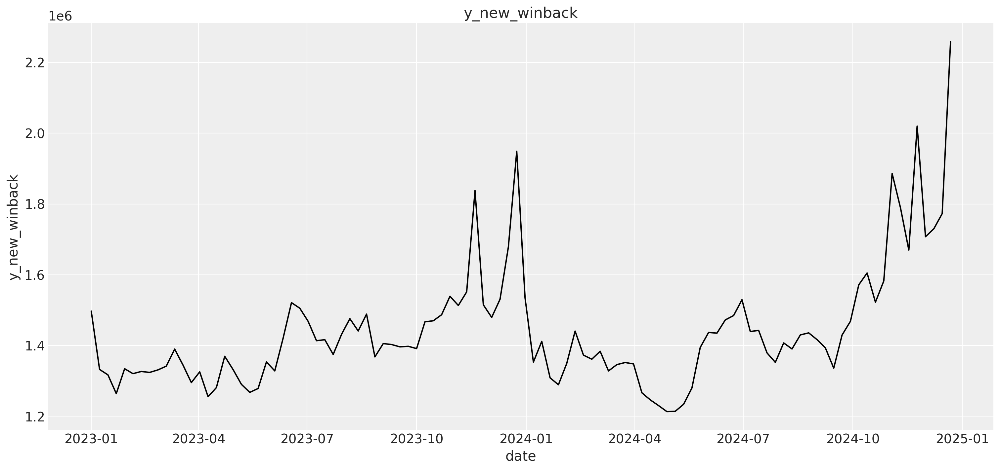

In [194]:
fig, ax = plt.subplots()
sns.lineplot(data=data_df, x=date_column, y=y_var, color="black", ax=ax)
ax.set(title=y_var, xlabel="date", ylabel=y_var);

This time series, which comes in weekly granularity, has a clear day of week seasonality pattern and some downward followed by upward trend.

Next, let's look into the marketing channels data. We first look into the share to get a feeling on the relative share across channels.   


,channel,spend,imps,spend_share,imps_share
13,Partnerships,111763269,19614462454,0.245513,0.377747
0,MACS App,10617629,8934633457,0.023324,0.172069
7,MACS Programmatic,111843098,5909668212,0.245688,0.113812
10,OO Linear,71418733,4223089219,0.156887,0.081331
8,MACS Social,17382607,3609618450,0.038185,0.069516
1,HMI Audio,4179038,2835522174,0.009180,0.054608
14,Podcast One Audio,53710184,1629589566,0.117986,0.031384
4,HMI OOH,13496847,1627163190,0.029649,0.031337
11,OO Video,19908239,1171072882,0.043733,0.022553
12,Paid Search,15708688,1134539603,0.034508,0.021850


/var/folders/kp/4w7zhccj5y15dty978bdp_1r0000gp/T/ipykernel_43269/2109116739.py:86: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


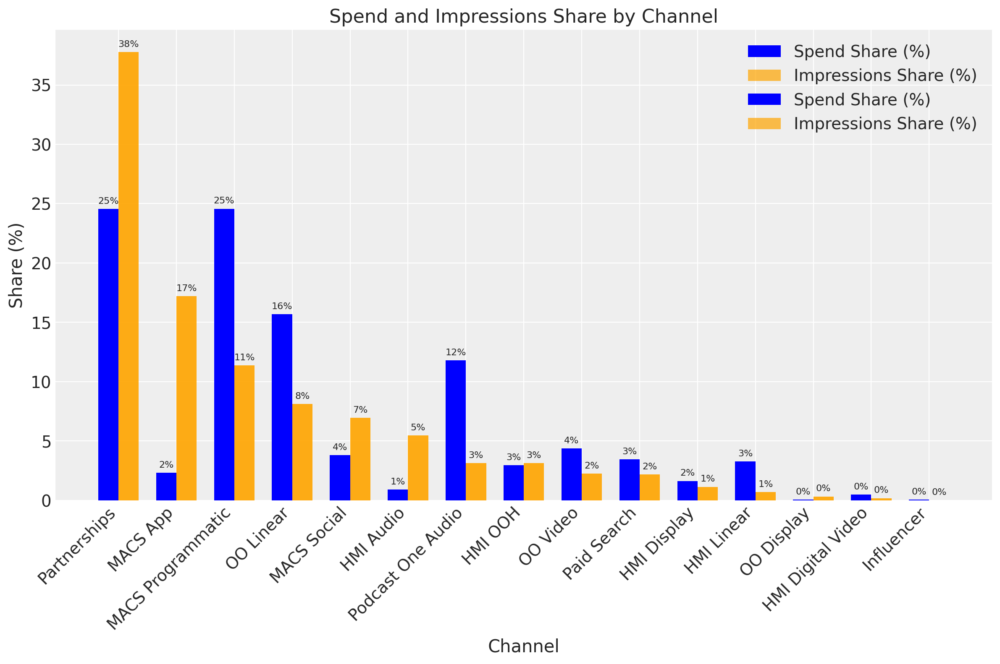

In [195]:


spend_columns = [
    col for col in weekly_df.columns if ("spend" in col)
]
imp_columns = [
    col for col in weekly_df.columns if ("imps" in col)
]

imp_plot_data = weekly_df.melt(
    value_vars=imp_columns, var_name="channel", value_name="imps"
).groupby("channel").agg({"imps": "sum"}).sort_values(by="imps")

#flatten the index
imp_plot_data = imp_plot_data.reset_index()
#convert the imps column to int
imp_plot_data["imps"] = imp_plot_data["imps"].astype(int)
imp_plot_data["channel"] = imp_plot_data["channel"].map(imps_channel_mapping)


spend_plot_data = weekly_df.melt(
    value_vars=spend_columns, var_name="channel", value_name="spend"
).groupby("channel").agg({"spend": "sum"})


spend_plot_data = spend_plot_data.reset_index()
#convert the spend column to int
spend_plot_data["spend"] = spend_plot_data["spend"].astype(int)
# Rename the values in channel column using the spend_channel_mapping
spend_plot_data["channel"] = spend_plot_data["channel"].map(spend_channel_mapping)
# Sort the values by spend
spend_plot_data = spend_plot_data

# join the two dataframes on channel
agg_plot_data = spend_plot_data.merge(imp_plot_data, on="channel", how="left").sort_values(by="imps", ascending=False)
agg_plot_data['spend_share'] = agg_plot_data['spend'] / agg_plot_data['spend'].sum()
agg_plot_data['imps_share'] = agg_plot_data['imps'] / agg_plot_data['imps'].sum()
display(agg_plot_data)

# Plot grouped bar chart of percentage share
channels = agg_plot_data['channel']
x = np.arange(len(channels))  # the label locations
width = 0.35  # the width of the bars

fig, ax = plt.subplots(figsize=(12, 8))

# Convert shares to percentages if necessary
if agg_plot_data['spend_share'].max() <= 1:
    agg_plot_data['spend_share'] = agg_plot_data['spend_share'] * 100
if agg_plot_data['imps_share'].max() <= 1:
    agg_plot_data['imps_share'] = agg_plot_data['imps_share'] * 100

ax.bar(x - width/2, agg_plot_data['spend_share'], width, label='Spend Share (%)', color="blue")
ax.bar(x + width/2, agg_plot_data['imps_share'], width, label='Impressions Share (%)', color="orange", alpha=0.7)


bars1 = ax.bar(x - width/2, agg_plot_data['spend_share'], width, label='Spend Share (%)', color="blue")
bars2 = ax.bar(x + width/2, agg_plot_data['imps_share'], width, label='Impressions Share (%)', color="orange", alpha=0.7)

# Add percentage labels on top of bars
for bar in bars1:
    height = bar.get_height()
    ax.annotate(f'{height:.0f}%',
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3),  # 3 points vertical offset
                textcoords="offset points",
                ha='center', va='bottom', fontsize=8)

for bar in bars2:
    height = bar.get_height()
    ax.annotate(f'{height:.0f}%',
                xy=(bar.get_x() + bar.get_width() / 2, height),
                xytext=(0, 3),
                textcoords="offset points",
                ha='center', va='bottom', fontsize=8)


# Set the x-ticks and labels
ax.set_xticks(x)
ax.set_xticklabels(channels, rotation=45, ha="right")

# Set labels and title
ax.set_ylabel('Share (%)')
ax.set_xlabel('Channel')
ax.set_title('Spend and Impressions Share by Channel')
ax.legend()

plt.tight_layout()
plt.show()

In this specific example we see that `Partnership` is the channel with the highest volume, followed by `App` and `Programmatic`. `Influencer` has the least volume

Next, we look into the time series of each of the marketing channels.

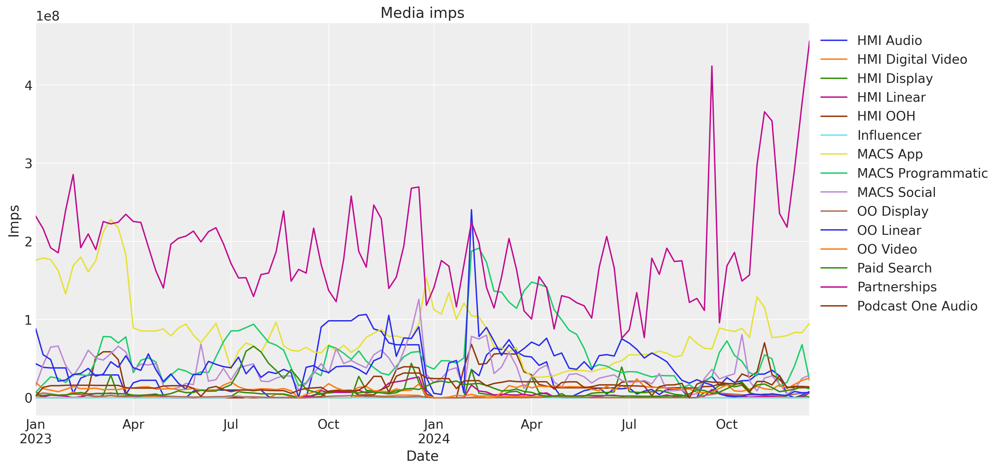

In [196]:
fig, ax = plt.subplots()
data_df = data_df.sort_values(by=date_column)  # Ensure the data is sorted by date
data_df.set_index(date_column)[channel_names].plot(ax=ax)
ax.legend(title="Channel", fontsize=12)
ax.set(title=f"Media {media_activity}", xlabel="Date", ylabel="Imps")
# set the legend to be outside the plot
ax.legend(loc="upper left", bbox_to_anchor=(1, 1))

We see an overall increase volume over time. This might explain the update trend in the y_var time series in 2nd half of 2025.

In [214]:
# create a dataframe of impressions by month and channel
monthly_imps = data_df.set_index(date_column).resample("M")[channel_names].sum()
monthly_imps = monthly_imps.reset_index()
monthly_imps[date_column] = monthly_imps[date_column].dt.strftime("%Y-%m")
monthly_imps = monthly_imps.melt(id_vars=[date_column], var_name="channel", value_name="imps")
# only include rows with channel names
monthly_imps = monthly_imps[monthly_imps["channel"].isin(channel_names)]
monthly_imps["imps"] = monthly_imps["imps"].astype(int)
monthly_imps=monthly_imps[monthly_imps["channel"].notna()]
monthly_imps = monthly_imps.sort_values(by=[date_column, "channel"])
monthly_imps = monthly_imps.reset_index(drop=True)
monthly_imps = monthly_imps.rename(columns={date_column: "month"})
monthly_imps["month"] = pd.to_datetime(monthly_imps["month"], format="%Y-%m")
monthly_imps

monthly_imps.to_csv("monthly_imps.csv", index=False)

Next, we can compute the correlation between the marketing channels and the y_var.

```{note}
We all know that correlation does not imply causation. However, it is a good idea to look into the correlation between the marketing channels and the target variable. This can hel us spot issues in the data (very commom in real cases) and inspire some feature engineering.
```

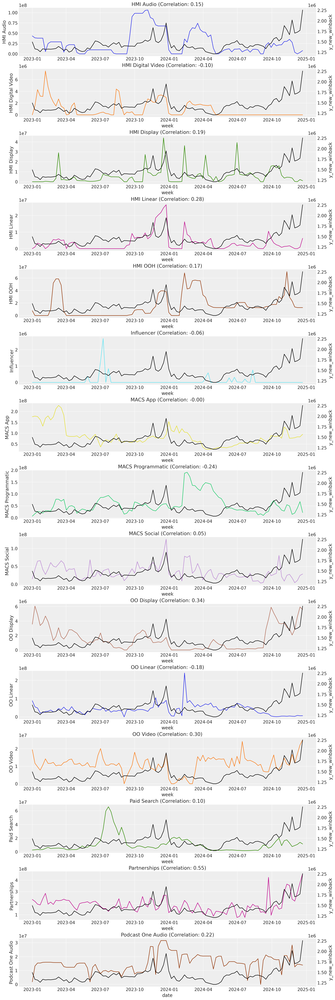

In [201]:
n_channels = len(channel_columns)

fig, axes = plt.subplots(
    nrows=n_channels,
    ncols=1,
    figsize=(15, 3 * n_channels),
    sharex=True,
    sharey=False,
    layout="constrained",
)

for i, channel in enumerate(channel_names):
    ax = axes[i]
    ax_twin = ax.twinx()
    sns.lineplot(data=data_df, x=date_column, y=channel, color=f"C{i}", ax=ax)
    sns.lineplot(data=data_df, x=date_column, y=y_var, color="black", ax=ax_twin)
    correlation = data_df[[channel, y_var]].corr().iloc[0, 1]
    ax_twin.grid(None)
    ax.set(title=f"{channel} (Correlation: {correlation:.2f})")
    # toggle on x-axis grid lines
    for ax in axes:
        ax.tick_params(labelbottom=True)
    

ax.set_xlabel("date");

The channels with the highest correlation with the sales are `TV`, `Insert`, and `Online Display`. Observe that the biggest channel in spend, `Direct Mail`, has the lowest correlation.

Let's look at potential lags in adstock given impressions volume over time and realized media contributions.

/Users/shua0225/pymc-marketing/pymc-marketing/.venv/lib/python3.11/site-packages/seaborn/axisgrid.py:123: UserWarning: The figure layout has changed to tight
  self._figure.tight_layout(*args, **kwargs)


ConversionError: Failed to convert value(s) to axis units: <DatetimeArray>
['2023-01-01 00:00:00', '2023-02-01 00:00:00', '2023-03-01 00:00:00',
 '2023-04-01 00:00:00', '2023-05-01 00:00:00', '2023-06-01 00:00:00',
 '2023-07-01 00:00:00', '2023-08-01 00:00:00', '2023-09-01 00:00:00',
 '2023-10-01 00:00:00', '2023-11-01 00:00:00', '2023-12-01 00:00:00',
 '2024-01-01 00:00:00', '2024-02-01 00:00:00', '2024-03-01 00:00:00',
 '2024-04-01 00:00:00', '2024-05-01 00:00:00', '2024-06-01 00:00:00',
 '2024-07-01 00:00:00', '2024-08-01 00:00:00', '2024-09-01 00:00:00',
 '2024-10-01 00:00:00', '2024-11-01 00:00:00', '2024-12-01 00:00:00']
Length: 24, dtype: datetime64[ns]

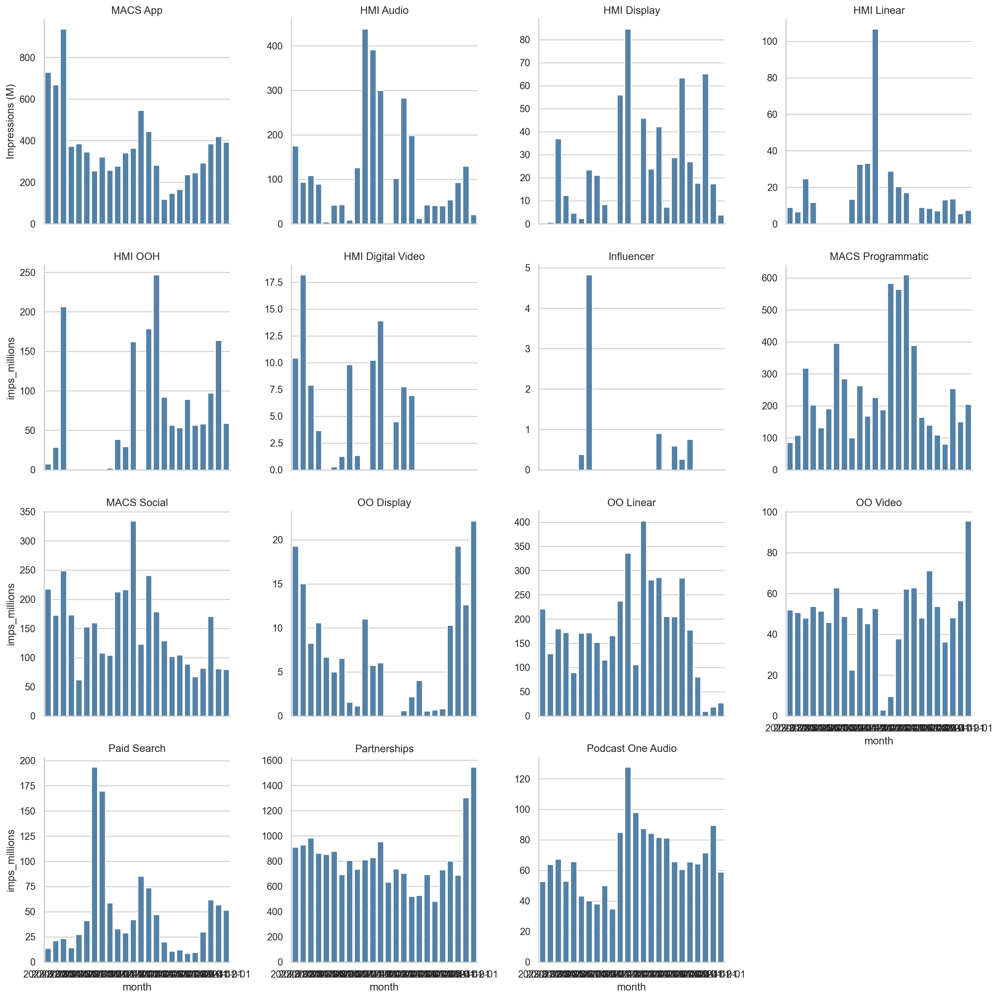

In [210]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Convert to month
monthly_df = raw_df.copy()
monthly_df["month"] = monthly_df["day_dt"].dt.to_period("M").dt.start_time

# Aggregate monthly impressions per channel
monthly_agg = monthly_df.groupby("month").agg(agg_dict).reset_index()

# Melt to long format
melted = monthly_agg.melt(
    id_vars="month", value_vars=imp_columns, var_name="channel", value_name="imps"
)

# Map channel names
melted["channel"] = melted["channel"].map(imps_channel_mapping)

# Convert impressions to millions
melted["imps_millions"] = melted["imps"] / 1e6
# Set up FacetGrid
sns.set_theme(style="whitegrid")
g = sns.FacetGrid(
    melted,
    col="channel",
    col_wrap=4,
    height=4,
    sharey=False
)
g.map_dataframe(sns.barplot, x="month", y="imps_millions", color="steelblue")

# Rotate x-tick labels and set titles
# Set titles, axis labels, and x-ticks
g.set_titles(col_template="{col_name}")
for ax in g.axes.flat:
    ax.set_ylabel("Impressions (M)")
    ax.set_xlabel("Month")
    ax.set_xticks(melted["month"].unique())
    ax.set_xticklabels(
        pd.to_datetime(melted["month"].unique()).strftime("%b %Y"),
        rotation=45,
        ha="right"
    )

plt.subplots_adjust(top=0.9)
g.fig.suptitle("Monthly Impressions per Channel", fontsize=16)
plt.tight_layout()


## Train Test Split

We are now ready to fit the model. We start by splitting the data into training and testing.


In a real case scenario you should use more data for training than for testing (see {ref}`mmm_time_slice_cross_validation`). In this case we are using a small dataset for demonstrative purposes.

In [ ]:
# calculate the date at 80% of the data
train_test_split_date = data_df[date_column].quantile(.75)
print("Train test split date:", train_test_split_date)


Train test split date: 2024-06-24 18:00:00


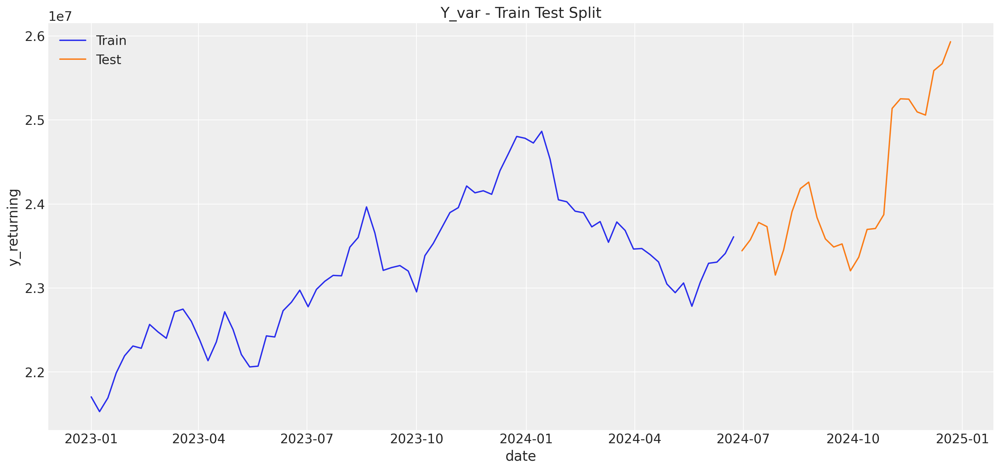

In [69]:

train_mask = data_df[date_column] <= train_test_split_date
test_mask = data_df[date_column] > train_test_split_date

train_df = data_df[train_mask]
test_df = data_df[test_mask]

fig, ax = plt.subplots()
sns.lineplot(data=train_df, x=date_column, y=y_var, color="C0", label="Train", ax=ax)
sns.lineplot(data=test_df, x=date_column, y=y_var, color="C1", label="Test", ax=ax)
ax.set(title="Y_var - Train Test Split", xlabel="date");

In [70]:
X_train = train_df.drop(columns=y_var)
X_test = test_df.drop(columns=y_var)

y_train = train_df[y_var]
y_test = test_df[y_var]

## Model Specification

Assuming we are working on the first iteration, we typically would not have lift tests data to calibrate the model. This is fine, we can start with a media volume priors to get started.


```{tip}
Ideally, in the next iteration we should have some of these lift tests to calibrate the model. For more details see {ref}`mmm_lift_test` and the {ref}`mmm_roas` case study notebook.
```

The idea behind the media volume priors is that we use the volume
 shares as a proxy for the effect of the media channels on the sales. This is not perfect but can be a good starting point. In essence, we are giving the higher volume
 channels more flexibility to fit the data with a wider prior. Let's see how this looks like. First, we compute the volume
 shares (on the training data!). 

/var/folders/kp/4w7zhccj5y15dty978bdp_1r0000gp/T/ipykernel_43269/2490550022.py:14: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(channel_names, rotation=45, ha="right")
/var/folders/kp/4w7zhccj5y15dty978bdp_1r0000gp/T/ipykernel_43269/2490550022.py:16: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_yticklabels([f"{int(x * 100)}%" for x in ax.get_yticks()])


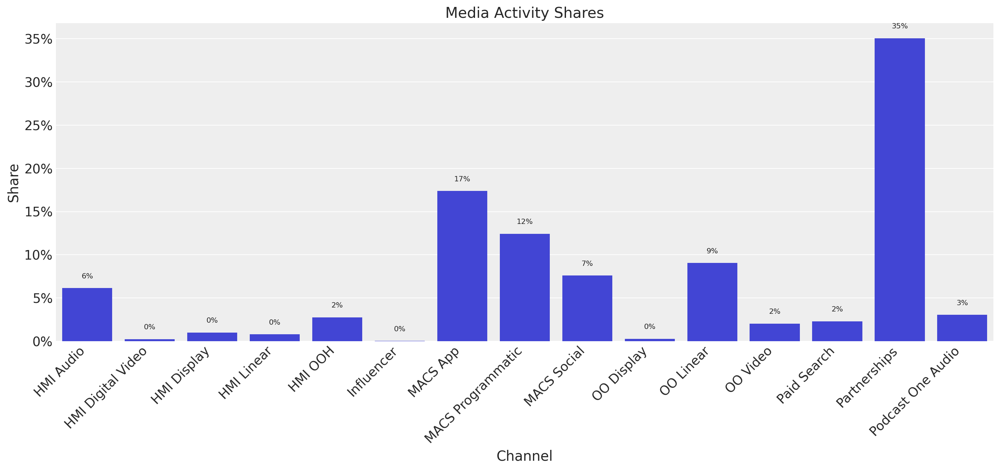

In [126]:
media_activity_shares = (
    X_train.melt(value_vars=channel_names, var_name="channel", value_name="media_activity")
    .groupby("channel", as_index=False)
    .agg({"media_activity": "sum"})
    .sort_values(by="channel")
    .assign(media_activity_share=lambda x: x["media_activity"] / x["media_activity"].sum())["media_activity_share"]
    .to_numpy()
)
# plot media activity shares
fig, ax = plt.subplots()
sns.barplot(x=channel_names, y=media_activity_shares, ax=ax)
ax.set(title="Media Activity Shares", xlabel="Channel", ylabel="Share")
# set the x-axis labels to be the channel names
ax.set_xticklabels(channel_names, rotation=45, ha="right")
# set the y-axis to be percentage
ax.set_yticklabels([f"{int(x * 100)}%" for x in ax.get_yticks()])
# label the bars
for i, v in enumerate(media_activity_shares):
    ax.text(i, v + 0.01, f"{int(v * 100)}%", ha="center", va="bottom", fontsize=8)

channel_columns: ['HMI Audio', 'HMI Digital Video', 'HMI Display', 'HMI Linear', 'HMI OOH', 'Influencer', 'MACS App', 'MACS Programmatic', 'MACS Social', 'OO Display', 'OO Linear', 'OO Video', 'Paid Search', 'Partnerships', 'Podcast One Audio']


/var/folders/kp/4w7zhccj5y15dty978bdp_1r0000gp/T/ipykernel_43269/3503400281.py:55: UserWarning: set_ticklabels() should only be used with a fixed number of ticks, i.e. after set_ticks() or using a FixedLocator.
  ax.set_xticklabels(sorted_channel_columns, rotation=45, ha="right")


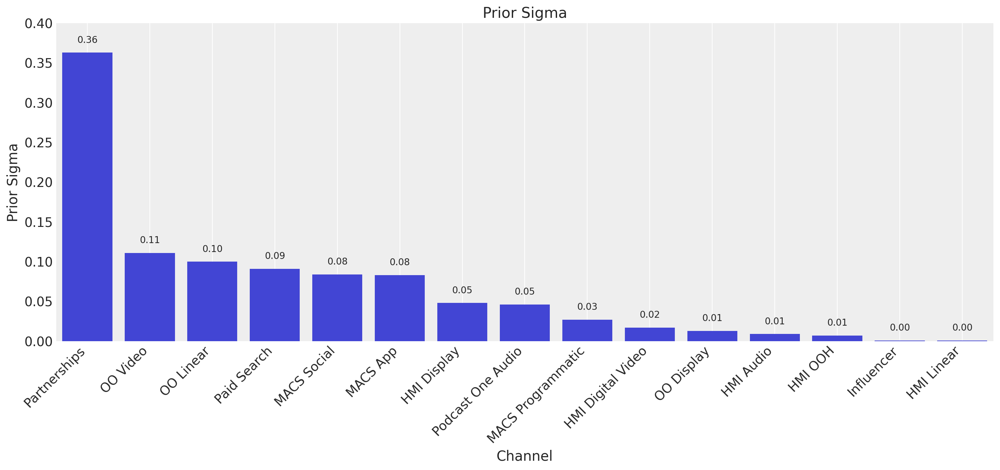

In [158]:
print("channel_columns:", channel_names)
'''
media_activity_shares = (
    X_train.melt(value_vars=channel_names, var_name="channel", value_name="media_activity")
    .groupby("channel", as_index=False)
    .agg({"media_activity": "sum"})
    .sort_values(by="channel")
    .assign(media_activity_share=lambda x: x["media_activity"] / x["media_activity"].sum())["media_activity_share"]
    .to_numpy()
)

prior_sigma = media_activity_shares
display(prior_sigma)
'''

# Use Jan 2023 Media Contribution from Deloitte's Models as Priors for sigma of channels
# It must be sorted in the same order as the channel_columns

jan_23_returning_media_contribution = {
    "Partnerships": 0.363,
    "OO Video": 0.111,
    "OO Linear": 0.100,
    "Paid Search": 0.091,
    "MACS Social": 0.084,
    "MACS App": 0.083,
    "HMI Display": 0.048,
    "Podcast One Audio": 0.046,
    "MACS Programmatic": 0.027,
    "HMI Digital Video": 0.017,
    "OO Display": 0.013,
    "HMI Audio": 0.009,
    "HMI OOH": 0.007,
    "HMI Linear": 0.001,
    "Influencer": 0.001,
}



prior_sigma = np.array(
    [
        jan_23_returning_media_contribution[channel]
        for channel in channel_names
    ]
)

# Sort channel_columns and prior_sigma by descending prior_sigma
sorted_indices = np.argsort(prior_sigma)[::-1]  # Sort indices in descending order
sorted_channel_columns = [channel_names[i] for i in sorted_indices]
sorted_prior_sigma = prior_sigma[sorted_indices]

# Plot the prior sigma with channel names
fig, ax = plt.subplots()
sns.barplot(x=sorted_channel_columns, y=sorted_prior_sigma, ax=ax)
ax.set(title="Prior Sigma", xlabel="Channel", ylabel="Prior Sigma")
ax.set_xticklabels(sorted_channel_columns, rotation=45, ha="right")
# label the bars
for i, v in enumerate(sorted_prior_sigma):
    ax.text(i, v + 0.01, f"{v:.2f}", ha="center", va="bottom")
ax.set_ylim(0, .4)
ax.grid()

Next, we use these volume shares to set the prior of the model using the model configuration.
    

In [159]:
#apply min-max absolute scaling to y_returning
y_train_scaled = (y_train - y_train.min()) / (y_train.max() - y_train.min())
# measure mean and sigma
y_train_mean = y_train_scaled.mean()
y_train_sigma = y_train_scaled.std()

y_train_mean, y_train_sigma 

Using prior knowledge of attribution windows for various channels, we can reverse enginge what alpha and beta should be for short and long attribution windows that we can then feed into the prior model config for alpha

In [160]:
from scipy.stats import beta, gamma

short_theta = .5
long_theta = 1

# Define the channels to be used in the short and long attribution windows
channel_windows = {
    "short": [
        "MACS App",
        "MACS Programmatic",
        "Influencer",
        "MACS Social",
        "Paid Search"
    ],
    "long": [
        "HMI Audio",
        "HMI Display",
        "HMI Linear",
        "HMI OOH",
        "HMI Digital Video",
        "OO Display",
        "OO Linear",
        "OO Video",
        "Partnerships",
        "Podcast One Audio"
    ]
}

# Create a dictionary to hold the alpha and beta parameters for each channel
channel_params = {}
for window, channels in channel_windows.items():
    for channel in channels:
        if window == "short":
            channel_params[channel] = short_theta
        else:
            channel_params[channel] = long_theta

# sort the channel_params dictionary by channel names
channel_params = dict(sorted(channel_params.items()))
# Print the channel parameters
print(channel_params)

# convert into a numpy array
prior_adstock_thetas = np.array(list(channel_params.values()))


{'HMI Audio': 1, 'HMI Digital Video': 1, 'HMI Display': 1, 'HMI Linear': 1, 'HMI OOH': 1, 'Influencer': 0.5, 'MACS App': 0.5, 'MACS Programmatic': 0.5, 'MACS Social': 0.5, 'OO Display': 1, 'OO Linear': 1, 'OO Video': 1, 'Paid Search': 0.5, 'Partnerships': 1, 'Podcast One Audio': 1}


Configure alpha and beta in determining adstock_alpha

In [ ]:
# Define short and long attribution windows
short_alpha, short_beta = 2, 5  # Earlier peak for short attribution window
long_alpha, long_beta = 5, 2    # Later peak for long attribution window

# Define the channels to be used in the short and long attribution windows
channel_windows = {
    "short": [
        "MACS App",
        "MACS Programmatic",
        "Influencer",
        "MACS Social",
        "Paid Search",
    ],
    "long": [
        "HMI Audio",
        "HMI Display",
        "HMI Linear",
        "HMI OOH",
        "HMI Digital Video",
        "OO Display",
        "OO Linear",
        "OO Video",
        "Partnerships",
        "Podcast One Audio",
    ],
}

# Create dictionaries for alpha and beta values for each channel
adstock_alpha_params = {}
adstock_beta_params = {}

for channel in channel_windows["short"]:
    adstock_alpha_params[channel] = short_alpha
    adstock_beta_params[channel] = short_beta

for channel in channel_windows["long"]:
    adstock_alpha_params[channel] = long_alpha
    adstock_beta_params[channel] = long_beta

# Ensure the parameters are sorted in the same order as the channel names
adstock_alpha_array = np.array([adstock_alpha_params[channel] for channel in channel_names])
adstock_beta_array = np.array([adstock_beta_params[channel] for channel in channel_names])

# Prior Configuration

In [ ]:
# default model configs if it is not specified in custom model_config
'''
mmm.default_model_config = {'intercept': Prior("Normal", mu=0, sigma=2),
 'likelihood': Prior("Normal", sigma=Prior("HalfNormal", sigma=2)),
 'gamma_control': Prior("Normal", mu=0, sigma=2, dims="control"),
 'gamma_fourier': Prior("Laplace", mu=0, b=1, dims="fourier_mode"),
 'intercept_tvp_config': HSGPKwargs(m=200, L=None, eta_lam=1.0, ls_mu=5.0, ls_sigma=10.0, cov_func=None),
 'media_tvp_config': HSGPKwargs(m=200, L=None, eta_lam=1.0, ls_mu=5.0, ls_sigma=10.0, cov_func=None),
 'adstock_alpha': Prior("Beta", alpha=[8.98634328 8.98634328 8.98634328 8.98634328 8.98634328 6.96443738
  6.96443738 6.96443738 6.96443738 8.98634328 8.98634328 8.98634328
  6.96443738 8.98634328 8.98634328], beta=[5.99089552 5.99089552 5.99089552 5.99089552 5.99089552 8.51209013
  8.51209013 8.51209013 8.51209013 5.99089552 5.99089552 5.99089552
  8.51209013 5.99089552 5.99089552], dims="channel"),
 'adstock_theta': Prior("HalfNormal", sigma=1, dims="channel"),
 'saturation_lam': Prior("Gamma", alpha=3, beta=1, dims="channel"),
 'saturation_beta': Prior("HalfNormal", sigma=[3.1300e-03 5.7900e-03 1.6610e-02 5.2000e-04 2.6100e-03 6.0000e-05
  2.9150e-02 9.4900e-03 2.9220e-02 4.4000e-03 3.4830e-02 3.8770e-02
  3.1810e-02 1.2688e-01 1.6100e-02], dims="channel")}
  
  '''

model_config = {
    "intercept": Prior("Normal", mu=0.3, sigma=.1), 
    #"intercept": Prior("TruncatedNormal", mu=0.5, sigma=0.1, lower=.5, upper=.7)
   #"gamma_control": Prior("Normal", mu=0, sigma=.05, dims="control"), 
    "gamma_control": Prior("TruncatedNormal", mu=0, sigma=0.07, lower=-0.15, upper=0.15, dims="control"),
    # Saturation
    "saturation_beta": Prior("HalfNormal", sigma=prior_sigma, dims="channel"),
    #"saturation_lam": Prior("Gamma", alpha=2, beta=4, dims="channel"), 
    # Adstock
    "adstock_alpha": Prior("Beta", alpha=adstock_alpha_array, beta=adstock_beta_array, dims="channel"),
   "adstock_theta": Prior("HalfNormal", sigma=prior_adstock_thetas, dims="channel"),
   # "likelihood": Prior("TruncatedNormal", lower=0, sigma=Prior("HalfNormal", sigma=3)),
    
}

We are now ready to specify the model (see {ref}`mmm_example` for more details). As the yearly seasonal component is not that strong, we use few Fourier terms.

In [162]:
sampler_config = {"progressbar": True}

mmm = MMM(
    model_config=model_config,
    sampler_config=sampler_config,
    date_column=date_column,
    adstock=DelayedAdstock(l_max=8),
    saturation=LogisticSaturation(),
    channel_columns=channel_names,
    control_columns=control_columns,
    time_varying_media=True,
    time_varying_intercept=True,
    yearly_seasonality=1 #annual

)


In [ ]:
mmm.default_model_config

{'intercept': Prior("Normal", mu=0, sigma=2),
 'likelihood': Prior("Normal", sigma=Prior("HalfNormal", sigma=2)),
 'gamma_control': Prior("Normal", mu=0, sigma=2, dims="control"),
 'gamma_fourier': Prior("Laplace", mu=0, b=1, dims="fourier_mode"),
 'intercept_tvp_config': HSGPKwargs(m=200, L=None, eta_lam=1.0, ls_mu=5.0, ls_sigma=10.0, cov_func=None),
 'media_tvp_config': HSGPKwargs(m=200, L=None, eta_lam=1.0, ls_mu=5.0, ls_sigma=10.0, cov_func=None),
 'adstock_alpha': Prior("Beta", alpha=1, beta=3, dims="channel"),
 'adstock_theta': Prior("HalfNormal", sigma=[1.  1.  1.  1.  1.  0.5 0.5 0.5 0.5 1.  1.  1.  0.5 1.  1. ], dims="channel"),
 'saturation_lam': Prior("Gamma", alpha=3, beta=1, dims="channel"),
 'saturation_beta': Prior("HalfNormal", sigma=[0.009 0.017 0.048 0.001 0.007 0.001 0.083 0.027 0.084 0.013 0.1   0.111
  0.091 0.363 0.046], dims="channel")}

## Prior Predictive Checks

We can now generate prior predictive samples to see how the model behaves under the prior specification.


[Text(0.5, 0, 'date'), Text(0, 0.5, 'y_returning')]

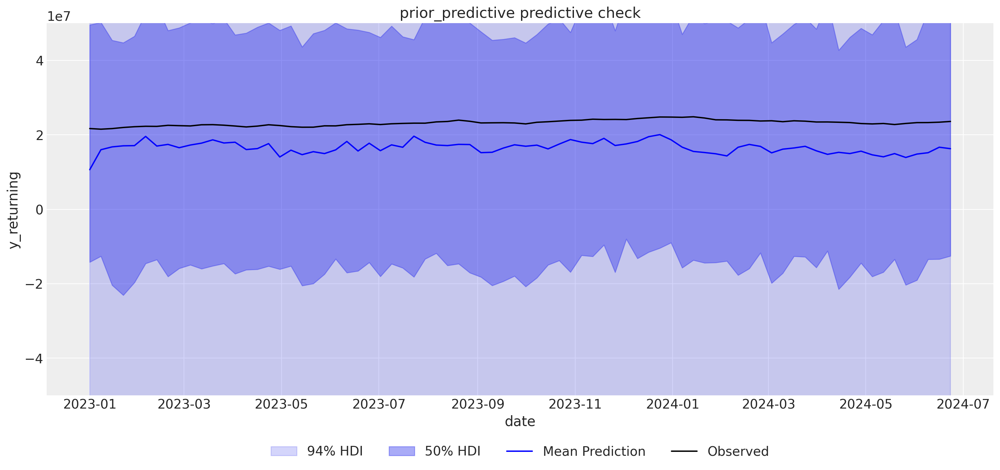

In [164]:
# Generate prior predictive samples
mmm.sample_prior_predictive(X_train, y_train, samples=4_000)
fig, ax = plt.subplots()
fig = mmm.plot_prior_predictive(original_scale=True, ax=ax)
# set y-axis to be in the range of y_var
ax.set_ylim(-0.5e8, 0.5e8)
ax.legend(loc="lower center", bbox_to_anchor=(0.5, -0.2), ncol=4)
ax.set(xlabel="date", ylabel=y_var)

The observed data (black line) lies within the 94% HDI, which suggests that the prior distributions are reasonably calibrated — they allow for a wide enough range of plausible outcomes that include the actual data.

The mean prior prediction (blue line) is consistently below the observed values. This indicates that while the prior allows for the observed values, there may be some weakness in the priors. Note that the choice of likelihood as a truncated normal (half-normal) is to avoid negative values for the target variable.

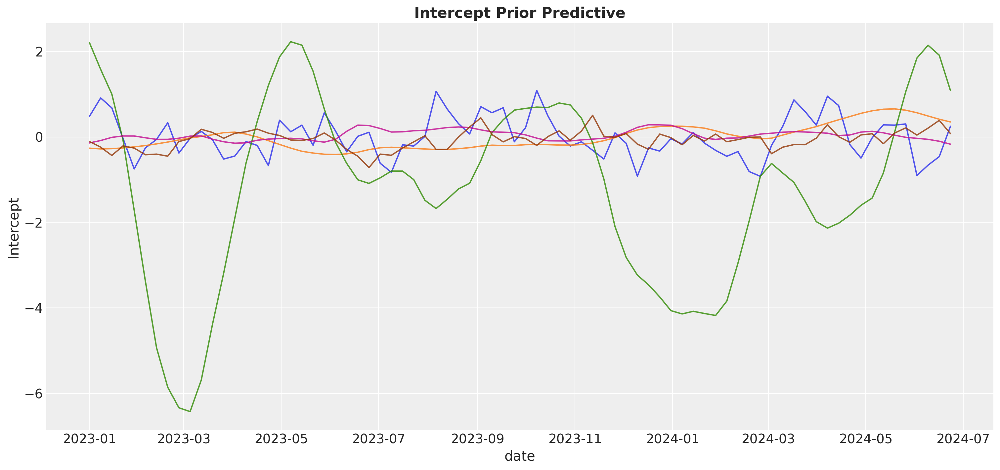

In [165]:
fig, ax = plt.subplots()


for draw in range(5):
    ax.plot(
        mmm.prior.coords["date"],
        mmm.prior["intercept_temporal_latent_multiplier_raw"].sel(chain=0, draw=draw),
        alpha=0.8,
    )
ax.set(xlabel="date", ylabel="Intercept")
ax.set_title("Intercept Prior Predictive", fontsize=16, fontweight="bold");

There are some wild swings.

Let's look into the channel contribution share **before** fitting the model.

Text(0.5, 0.98, 'Channel Contribution Share (Descending Order)')

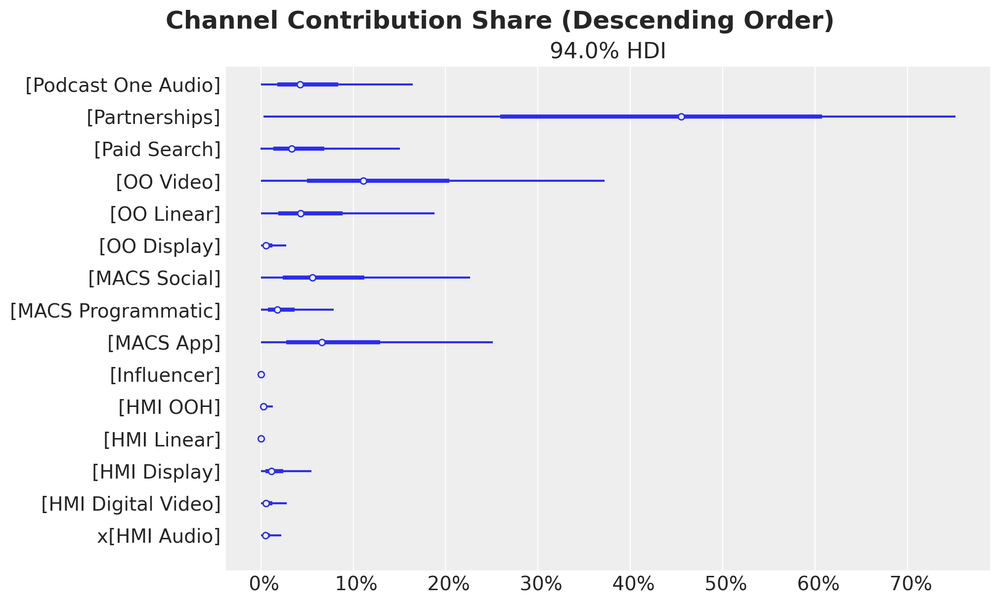

In [166]:
fig = mmm.plot_channel_contribution_share_hdi(prior=True, figsize=(10, 6))
fig.gca().invert_yaxis()  # Invert the y-axis to rank by descending share
fig.suptitle("Channel Contribution Share (Descending Order)", fontsize=18, fontweight="bold")

We confirm these represent the volume shares as expected from the prior specification.

## Model Fitting

We now fit the model to the training data.

In [167]:

nuts_sampler="numpyro"
print("model config:", pprint.pprint(model_config))
print("channel columns:", channel_names)
print("control columns:", control_columns)

mmm.fit(
    X=X_train,
    y=y_train,
    target_accept=0.9,
    chains=4,
    draws=2000,
    nuts_sampler=nuts_sampler,
    random_seed=rng,
)


{'adstock_theta': Prior("HalfNormal", sigma=[1.  1.  1.  1.  1.  0.5 0.5 0.5 0.5 1.  1.  1.  0.5 1.  1. ], dims="channel"),
 'gamma_control': Prior("TruncatedNormal", mu=0, sigma=0.07, lower=-0.15, upper=0.15, dims="control"),
 'intercept': Prior("Normal", mu=0.3, sigma=0.1),
 'saturation_beta': Prior("HalfNormal", sigma=[0.009 0.017 0.048 0.001 0.007 0.001 0.083 0.027 0.084 0.013 0.1   0.111
 0.091 0.363 0.046], dims="channel")}
model config: None
channel columns: ['HMI Audio', 'HMI Digital Video', 'HMI Display', 'HMI Linear', 'HMI OOH', 'Influencer', 'MACS App', 'MACS Programmatic', 'MACS Social', 'OO Display', 'OO Linear', 'OO Video', 'Paid Search', 'Partnerships', 'Podcast One Audio']
control columns: ['event_anomaly_12_17_23day_b4_xmas_eve_2023', 'event_anomaly_3_14_2024', 'event_anomaly_3_24_23anomaly_3_25_23', 'event_anomaly_3_26_23anomaly_3_27_23anomaly_3_28_23', 'event_ind_2023', 'event_ind_2024', 'event_juneteenth_2023', 'event_juneteenth_2024', 'event_lab_2023', 'event_lab_2

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

  0%|          | 0/3000 [00:00<?, ?it/s]

There were 49 divergences after tuning. Increase `target_accept` or reparameterize.
The rhat statistic is larger than 1.01 for some parameters. This indicates problems during sampling. See https://arxiv.org/abs/1903.08008 for details
The effective sample size per chain is smaller than 100 for some parameters.  A higher number is needed for reliable rhat and ess computation. See https://arxiv.org/abs/1903.08008 for details


Inference data with groups:
	> posterior
	> sample_stats
	> prior
	> prior_predictive
	> observed_data
	> constant_data
	> fit_data

## Model Diagnostics

Before looking into the results let's check some diagnostics including divergence

In [168]:

mmm.idata["sample_stats"]["diverging"].sum().item()

In [169]:
# provide the r_hat for each parameter
az.summary(
    data=mmm.idata,
    var_names=[
        "intercept",
        "y_sigma",
        "saturation_beta",
        "saturation_lam",
        "adstock_alpha",
        "gamma_control",
    ],
)["r_hat"].describe()

count    149.000000
mean       1.000067
std        0.000819
min        1.000000
25%        1.000000
50%        1.000000
75%        1.000000
max        1.010000
Name: r_hat, dtype: float64

In [170]:

# define param_names
param_names = list(mmm.idata.posterior.data_vars)
# define n_params
n_params = len(param_names)

fig, axes = plt.subplots(nrows=n_params, figsize=(15, 3 * n_params), sharex=False)

if n_params == 1:
    axes = [axes]

for i, param in enumerate(param_names):
    values = mmm.idata.posterior[param].values.flatten()
    axes[i].hist(values, bins=50, density=True)
    axes[i].set_title(param)
    axes[i].grid(True)

plt.tight_layout()
plt.show()


/var/folders/kp/4w7zhccj5y15dty978bdp_1r0000gp/T/ipykernel_43269/3752779570.py:17: UserWarning: The figure layout has changed to tight
  plt.tight_layout()


We do not have divergent transitions, which is good!

On the other hand, the R-hat statistics are all close to 1, which is also good!

Next let's look into the model trace.

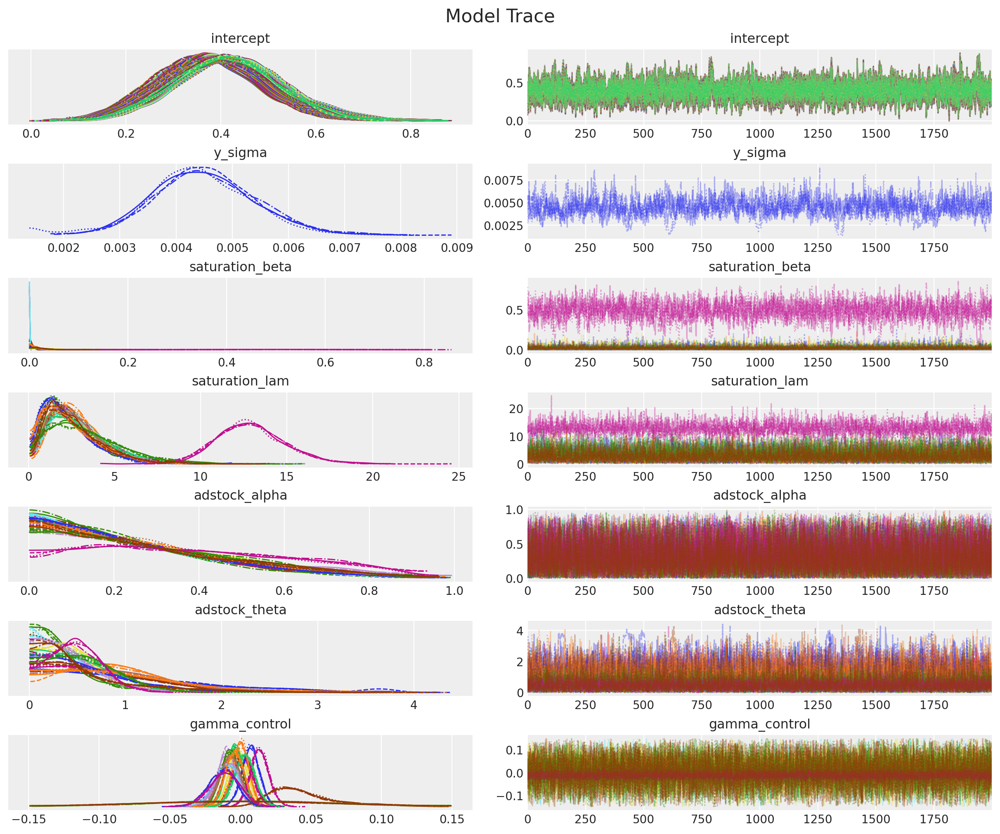

In [171]:
_ = az.plot_trace(
    data=mmm.fit_result,
    var_names=[
        "intercept",
        "y_sigma",
        "saturation_beta",
        "saturation_lam",
        "adstock_alpha",
        "adstock_theta",
        "gamma_control",
    ],
    compact=True,
    backend_kwargs={"figsize": (12, 10), "layout": "constrained"},
)
plt.gcf().suptitle("Model Trace", fontsize=16);

We see a good mixing in the trace, which is consistent with the good R-hat statistics.

## Posterior Predictive Checks

As our model and posterior samples are looking good, we can now look into the posterior predictive checks.

Output()

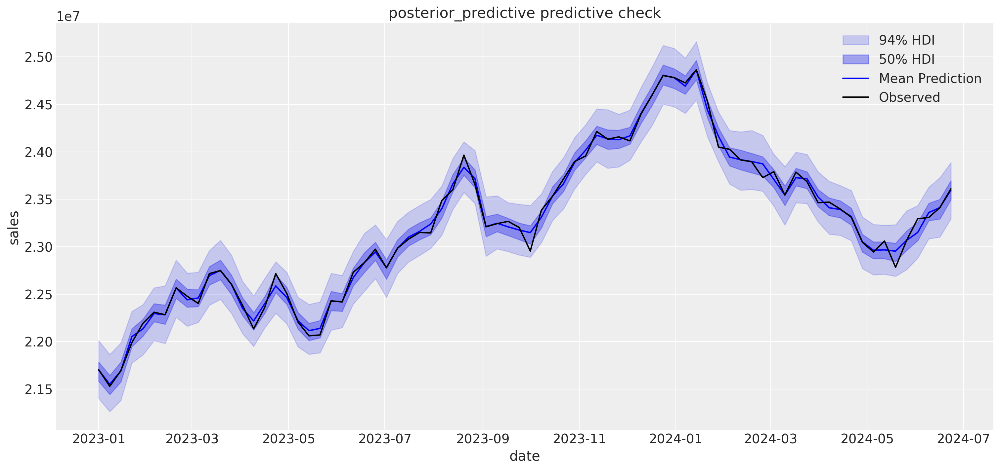

In [172]:
mmm.sample_posterior_predictive(X_train, extend_idata=True, combined=True)
fig = mmm.plot_posterior_predictive(original_scale=True)
fig.gca().set(xlabel="date", ylabel="sales");

The posterior predictive sales look quite reasonable. We are explaining a good amount of the variance in the data and the trends are well captured.

We can look into the errors of the model:

We do not detect any obvious patterns in the errors.

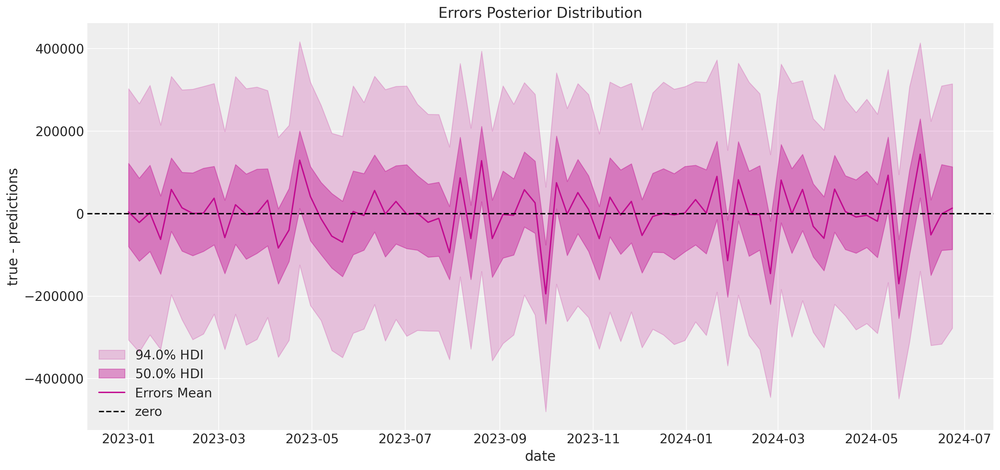

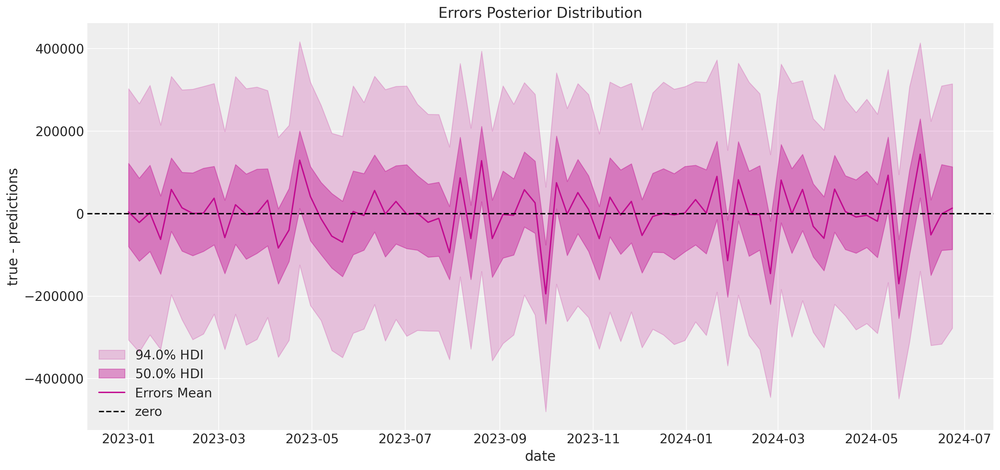

In [173]:
# Plot the errors
mmm.plot_errors(original_scale=True)

## Media Deep Dive

In this section we perform a deep dive into the media channels insights.

### Channel Contributions


Now that we are happy with the global model fit, we can look into the media and individual channels contributions.

We start by looking into the aggregated contributions.


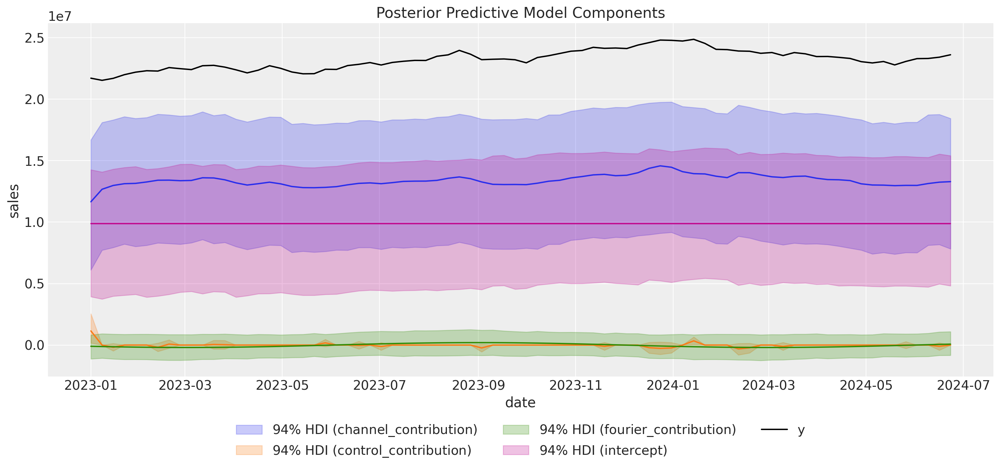

In [174]:
fig = mmm.plot_components_contributions(original_scale=True)
fig.gca().set(xlabel="date", ylabel="sales");

Next, we look into deeper into the components:

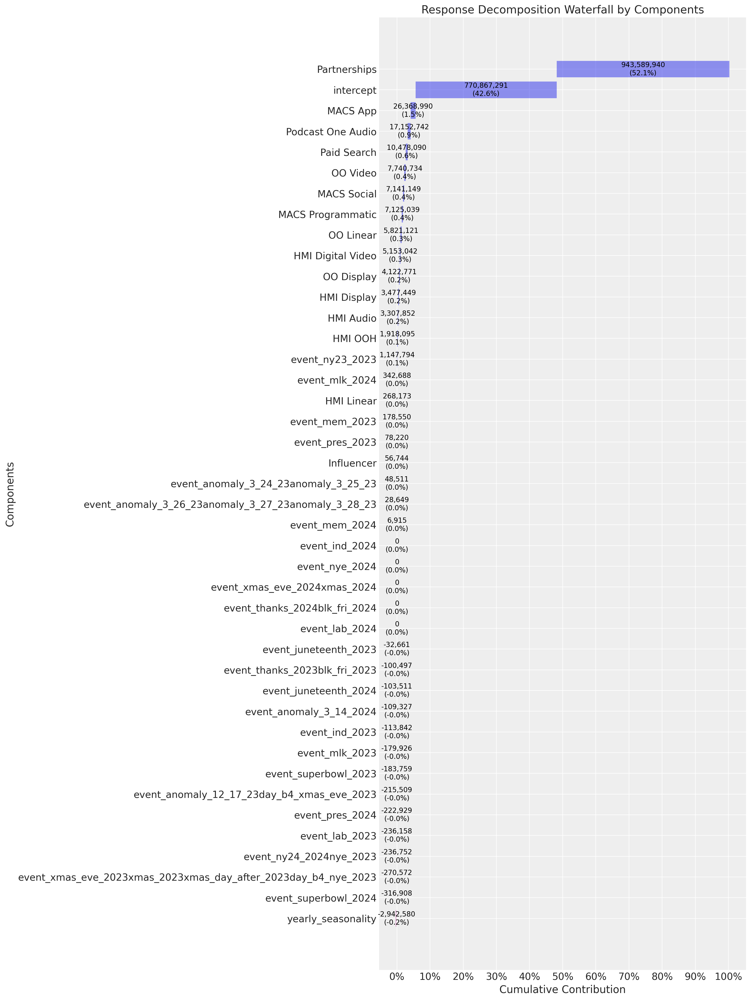

In [175]:
mmm.plot_waterfall_components_decomposition(figsize=(15, 20));

Here are some interesting observations about the model:

- The `intercept` accounts for approximately $60\%$ of the contribution. This is what people usually call the "baseline".
- The top media contribution channels are `Online Display`, `Direct Mail` and `TV`. In some sense we see how the model is averaging the spend share (prior) and the predictive power of the media channels (posterior)
.

### Saturation Curves

We continue our analysis by looking into the direct response curves. These will be the main input for the budget optimization step below.

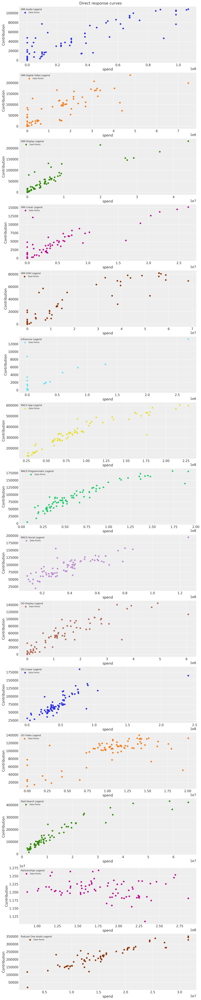

In [176]:
fig = mmm.plot_direct_contribution_curves()
[ax.set(xlabel="spend") for ax in fig.axes];

```{tip}
These curves by themselves can be a great input for marketing planning! One could use them to set the budget for the next periods and manually optimize the spend for these channels depending on the saturation points. This process can be a good starting point with engage with the team. That being said, we can do better with custom optimization rutines as described in the following sections.
```

Beside the direct response curves, we can look intro global contribution plots simulations. The idea is to vary the spend by globally multiplying the time series spend by a value $\delta > 0$ and seeing the expected contribution. PyMC-Marketing also shows the $94\%$ Highest Density Interval (HDI) of the simulations results.

/Users/shua0225/pymc-marketing/pymc-marketing/.venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


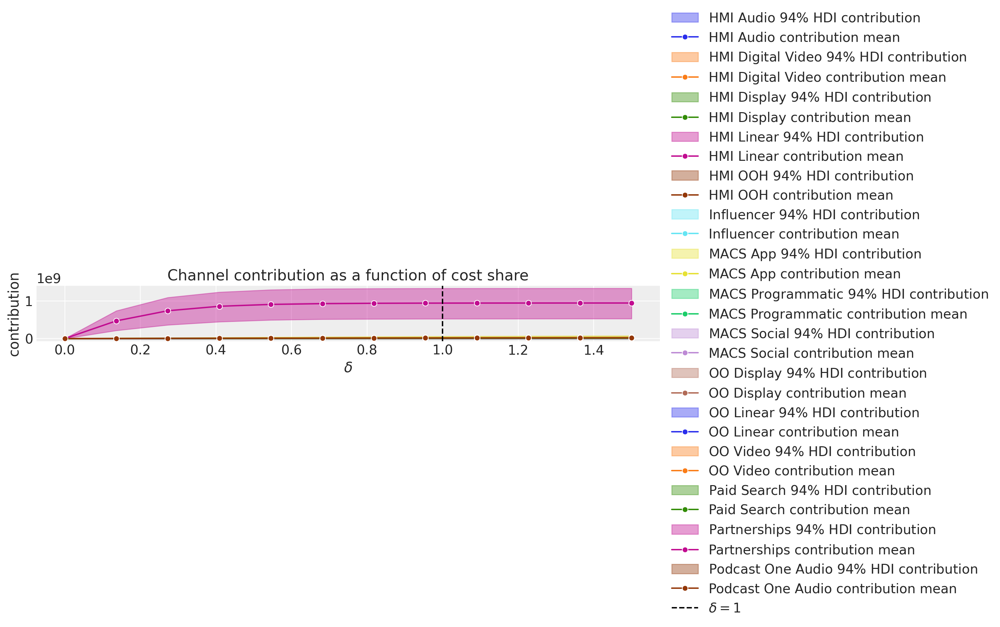

In [177]:
mmm.plot_channel_contributions_grid(start=0, stop=1.5, num=12, figsize=(15, 7));

We can clearly see the saturation effects for the different channels.

A complementary plot is to plot these same simulations against the actual spend:

/Users/shua0225/pymc-marketing/pymc-marketing/.venv/lib/python3.11/site-packages/IPython/core/events.py:82: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
  func(*args, **kwargs)
/Users/shua0225/pymc-marketing/pymc-marketing/.venv/lib/python3.11/site-packages/IPython/core/pylabtools.py:170: UserWarning: constrained_layout not applied because axes sizes collapsed to zero.  Try making figure larger or Axes decorations smaller.
  fig.canvas.print_figure(bytes_io, **kw)


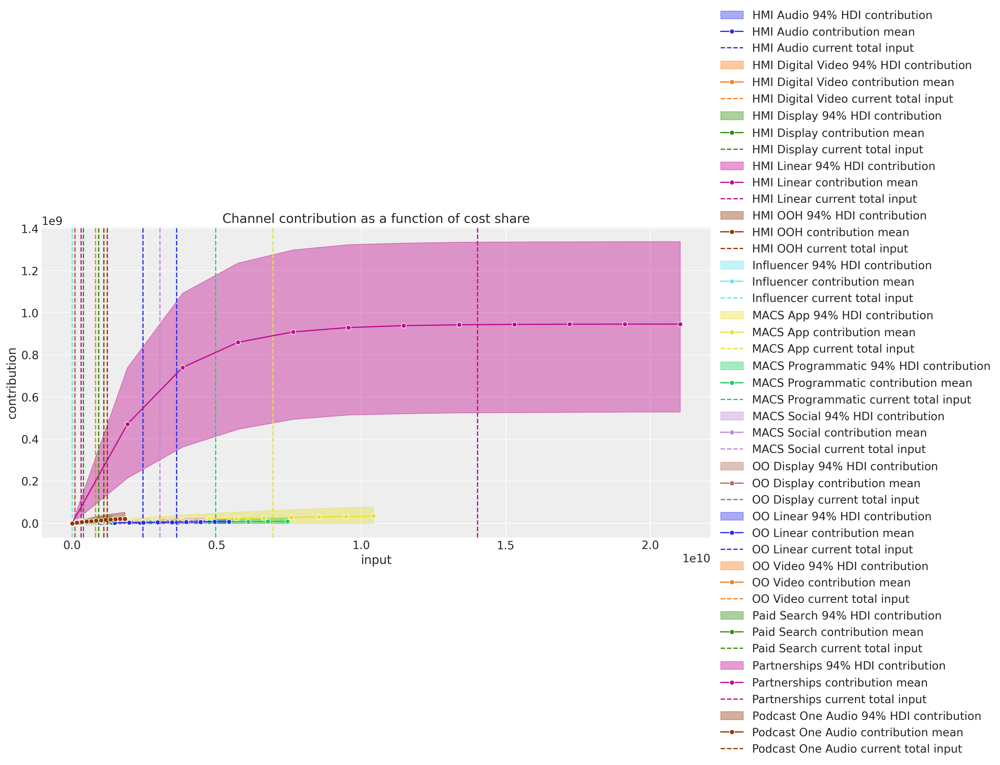

In [178]:
mmm.plot_channel_contributions_grid(
    start=0, stop=1.5, num=12, absolute_xrange=True, figsize=(15, 7)
);

The vertical lines show the spend from the observed data (i.e. $\delta = 1 $ above). This plot clearly shows that, for example, `Direct Mail` is won't have much incremental contribution if we keep increasing the spend. On the other hand, channels like `Online Display` and `Insert` seem to be good candidates to increase the spend. These are the concrete actionable insights you can extract from these typo of models to optimize your media spend mix 🚀!

### Return on Ads Spend (ROAS)

To have a more quantitative metric of efficiency we compute the Return on Ads Spend (ROAS) over the whole training period.

To begin lets plot the contribution share for each channel.

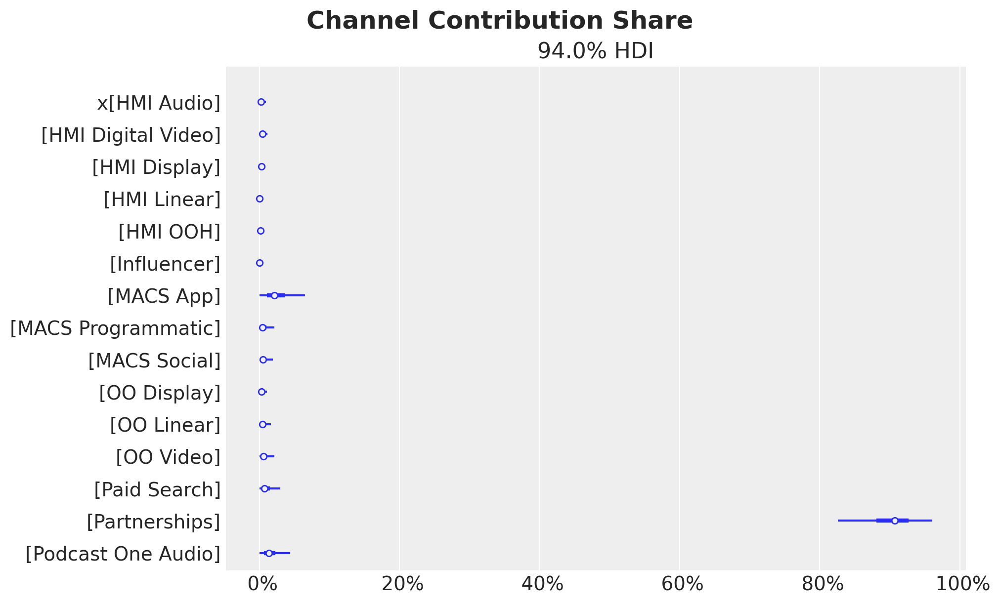

In [179]:
fig = mmm.plot_channel_contribution_share_hdi(figsize=(10, 6))
fig.suptitle("Channel Contribution Share", fontsize=18, fontweight="bold");

These contributions are of course influences by the spend levels. If we want to get a better picture of the efficiency of each channel we need to look into the Return on Ads Spend (ROAS). This is done by computing the ratio of the mean contribution and the spend for each channel.

In [180]:
# Get the channel contributions on the original scale
channel_contribution_original_scale = mmm.compute_channel_contribution_original_scale()

# Sum the contributions over the whole training period
spend_sum = X_train[channel_columns].sum().to_numpy()
spend_sum = spend_sum[
    np.newaxis, np.newaxis, :
]  # We need these extra dimensions to broadcast the spend sum to the shape of the contributions.

# Compute the ROAS as the ratio of the mean contribution and the spend for each channel
roas_samples = channel_contribution_original_scale.sum(dim="date") / spend_sum

# Plot the ROAS
fig, ax = plt.subplots(figsize=(10, 6))
az.plot_forest(roas_samples, combined=True, ax=ax)
fig.suptitle("Return on Ads Spend (ROAS)", fontsize=18, fontweight="bold");

KeyError: "None of [Index(['channel_app_imps', 'channel_hmi_audio_imps',\n       'channel_hmi_display_imps', 'channel_hmi_linear_imps',\n       'channel_hmi_ooh_imps', 'channel_hmi_video_imps',\n       'channel_influencer_imps', 'channel_macs_programmatic_imps',\n       'channel_macs_social_imps', 'channel_oo_display_imps',\n       'channel_oo_linear_imps', 'channel_oo_video_imps',\n       'channel_paid_search_imps', 'channel_partnerships_imps',\n       'channel_podcast_one_imps'],\n      dtype='object')] are in the [columns]"

Here we see that the channels with the highest ROAS **on average** are `Online Display` and `Insert` whereas `Direct Mail` has the lowest ROAS. This is consistent with the previous findings analyzing the direct and global response curves.

```{tip}
The large HDI intervals for the ROAS for the top channels come from the fact that the spend share of them during the training period is relatively small. Event though we use the spend share as priors, the overall spend levels are also reflected in the estimate (see for example how small the HDI is for `Direct Mail`).

We can see this as an opportunity! Based on this analysis we see that `Online Display` and `Insert` are the best channels to invest in. Hence, if we optimize our budget accordingly (more on the budget optimization below) we can improve our marketing mix and at the same time create more variance in the training data so that we get refined ROAS estimates for future iterations 😎.
```

It is also useful to compare the ROAS and the contribution share.

NameError: name 'spend_shares' is not defined

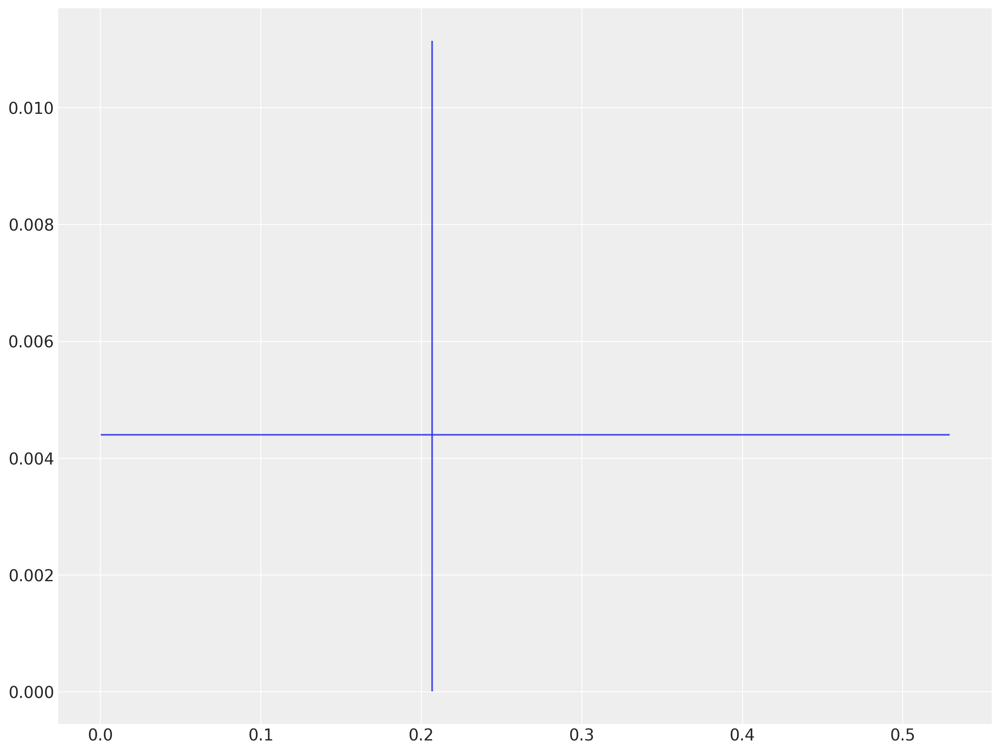

In [ ]:
# Get the contribution share samples
share_samples = mmm.get_channel_contributions_share_samples()

fig, ax = plt.subplots(figsize=(12, 9))

for i, channel in enumerate(channel_columns):
    # Contribution share mean and hdi
    share_mean = share_samples.sel(channel=channel).mean().to_numpy()
    share_hdi = az.hdi(share_samples.sel(channel=channel))["x"].to_numpy()

    # ROAS mean and hdi
    roas_mean = roas_samples.sel(channel=channel).mean().to_numpy()
    roas_hdi = az.hdi(roas_samples.sel(channel=channel))["x"].to_numpy()

    # Plot the contribution share hdi
    ax.vlines(share_mean, roas_hdi[0], roas_hdi[1], color=f"C{i}", alpha=0.8)

    # Plot the ROAS hdi
    ax.hlines(roas_mean, share_hdi[0], share_hdi[1], color=f"C{i}", alpha=0.8)

    # Plot the means
    ax.scatter(
        share_mean,
        roas_mean,
        # Size of the scatter points is proportional to the spend share
        s=5 * (spend_shares[i] * 100),
        color=f"C{i}",
        edgecolor="black",
        label=channel,
    )
ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{x:.0%}"))

ax.legend(
    bbox_to_anchor=(1.05, 1), loc="upper left", title="Channel", title_fontsize=12
)
ax.set(
    title="Channel Contribution Share vs ROAS",
    xlabel="Contribution Share",
    ylabel="ROAS",
);

## Out-of-Sample Predictions

Until now we have analyzed the model fit from the in-sample perspective. If we want to follow the model recommendations, we need to have evidence that the model is not only good in explaining the past but also good at making predictions. This is a key component to getting the buy in from the business stakeholders.

The PyMC-Marketing MMM API allows to easily generate out-of-sample predictions from a fitted model as follows:


In [ ]:
y_pred_test = mmm.sample_posterior_predictive(
    X_test,
    include_last_observations=True,
    original_scale=True,
    var_names=["y", "channel_contributions"],
    extend_idata=False,
    progressbar=False,
    random_seed=rng,
)

We can visualize and compare the in sample and out of sample predictions.

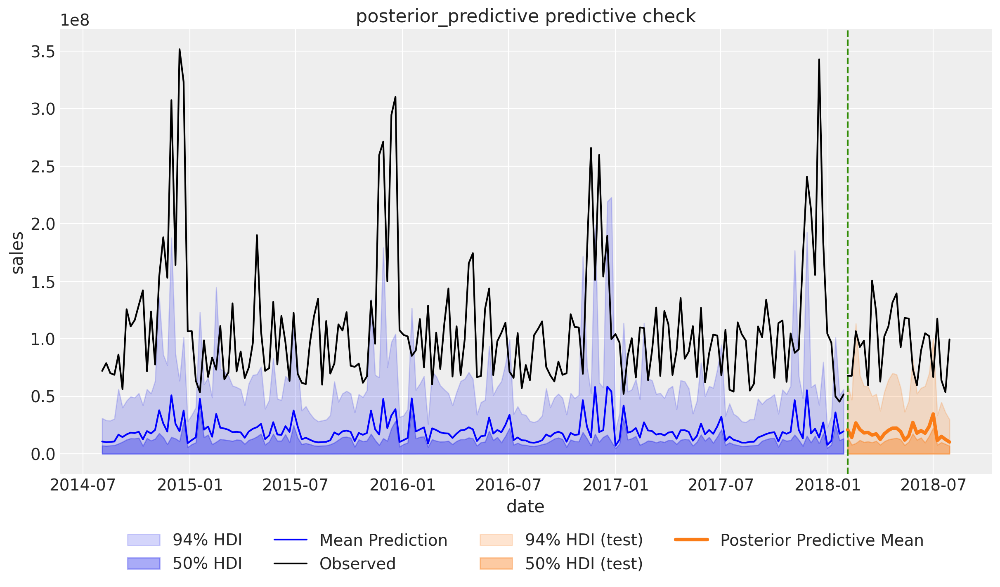

In [ ]:
fig, ax = plt.subplots()
mmm.plot_posterior_predictive(original_scale=True, ax=ax)

test_hdi_94 = az.hdi(y_pred_test["y"].to_numpy().T, hdi_prob=0.94)
test_hdi_50 = az.hdi(y_pred_test["y"].to_numpy().T, hdi_prob=0.50)

ax.fill_between(
    X_test[date_column],
    test_hdi_94[:, 0],
    test_hdi_94[:, 1],
    color="C1",
    label=f"{0.94:.0%} HDI (test)",
    alpha=0.2,
)

ax.fill_between(
    X_test[date_column],
    test_hdi_50[:, 0],
    test_hdi_50[:, 1],
    color="C1",
    label=f"{0.50:.0%} HDI (test)",
    alpha=0.4,
)

ax.plot(X_test[date_column], y_test, color="black")
ax.plot(
    X_test[date_column],
    y_pred_test["y"].mean(dim="sample"),
    color="C1",
    linewidth=3,
    label="Posterior Predictive Mean",
)
ax.axvline(X_test[date_column].iloc[0], color="C2", linestyle="--")
ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.1), ncol=4)
ax.set(ylabel="sales");

Overall, both the in-sample and out-of-sample predictions look very reasonable.

Let's zoom in the out-of-sample predictions:

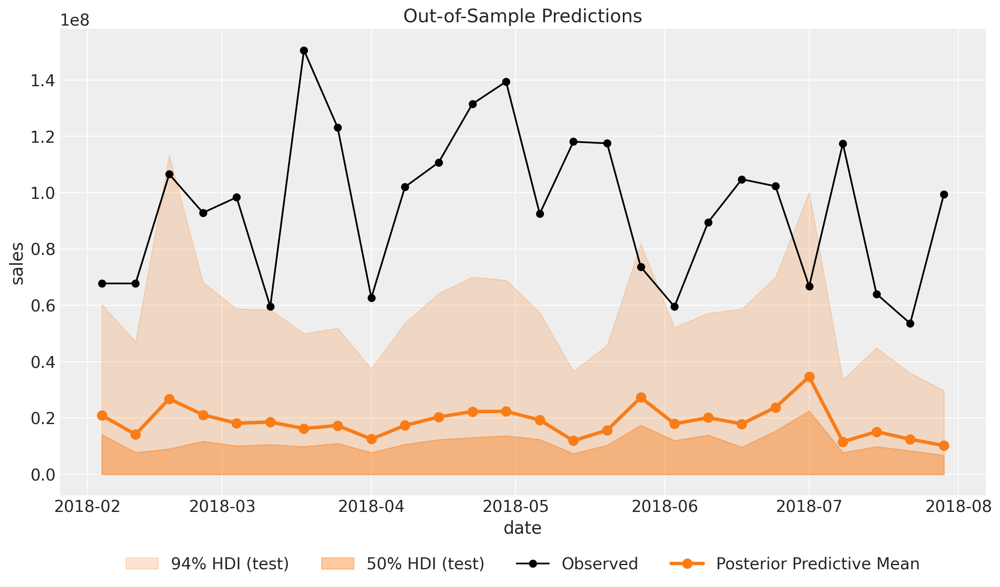

In [ ]:
fig, ax = plt.subplots()
ax.fill_between(
    X_test[date_column],
    test_hdi_94[:, 0],
    test_hdi_94[:, 1],
    color="C1",
    label=f"{0.94:.0%} HDI (test)",
    alpha=0.2,
)
ax.fill_between(
    X_test[date_column],
    test_hdi_50[:, 0],
    test_hdi_50[:, 1],
    color="C1",
    label=f"{0.50:.0%} HDI (test)",
    alpha=0.4,
)
ax.plot(X_test[date_column], y_test, marker="o", color="black", label="Observed")
ax.plot(
    X_test[date_column],
    y_pred_test["y"].mean(dim="sample"),
    marker="o",
    markersize=8,
    color="C1",
    linewidth=3,
    label="Posterior Predictive Mean",
)
ax.legend(loc="upper center", bbox_to_anchor=(0.5, -0.1), ncol=4)
ax.set(title="Out-of-Sample Predictions", xlabel="date", ylabel="sales");

These look actually very good!



To have a concrete score metric we can use the Continuous Ranked Probability Score ([CRPS](https://towardsdatascience.com/crps-a-scoring-function-for-bayesian-machine-learning-models-dd55a7a337a8)). This is a generalization of the mean absolute error to the case of probabilistic predictions. For more detail see the {ref}`mmm_time_slice_cross_validation` notebook.

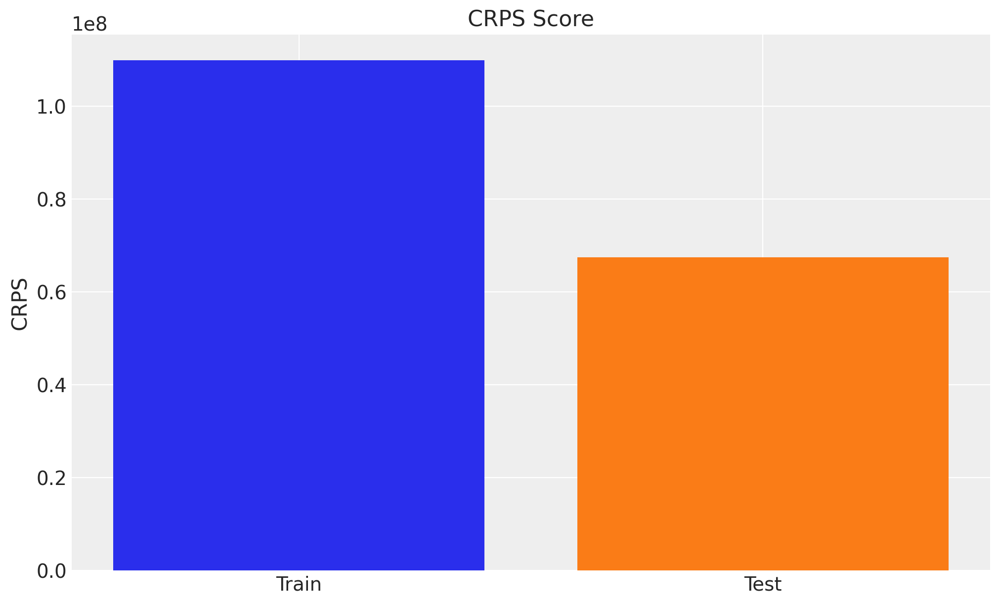

In [ ]:
crps_train = crps(
    y_true=y_train.to_numpy(),
    y_pred=az.extract(mmm.idata["posterior_predictive"], var_names=["y"]).T,
)

crps_test = crps(y_true=y_test.to_numpy(), y_pred=y_pred_test["y"].T)

fig, ax = plt.subplots(figsize=(10, 6))
ax.bar(["Train", "Test"], [crps_train, crps_test], color=["C0", "C1"])
ax.set(ylabel="CRPS", title="CRPS Score");

Interestingly enough, the model performance is better in the test set. There could me many reasons for it:

- The model is not capturing the end of the seasonality very well in the training set.
- There is less variability or complexity in the test set data.
- The test set has fewer points, which could affect the CRPS calculation comparison.

In order to have a better comparison we should look into the time slice cross validation results as in the {ref}`mmm_time_slice_cross_validation` notebook.

Next, we look into the out-of-sample channel contributions.

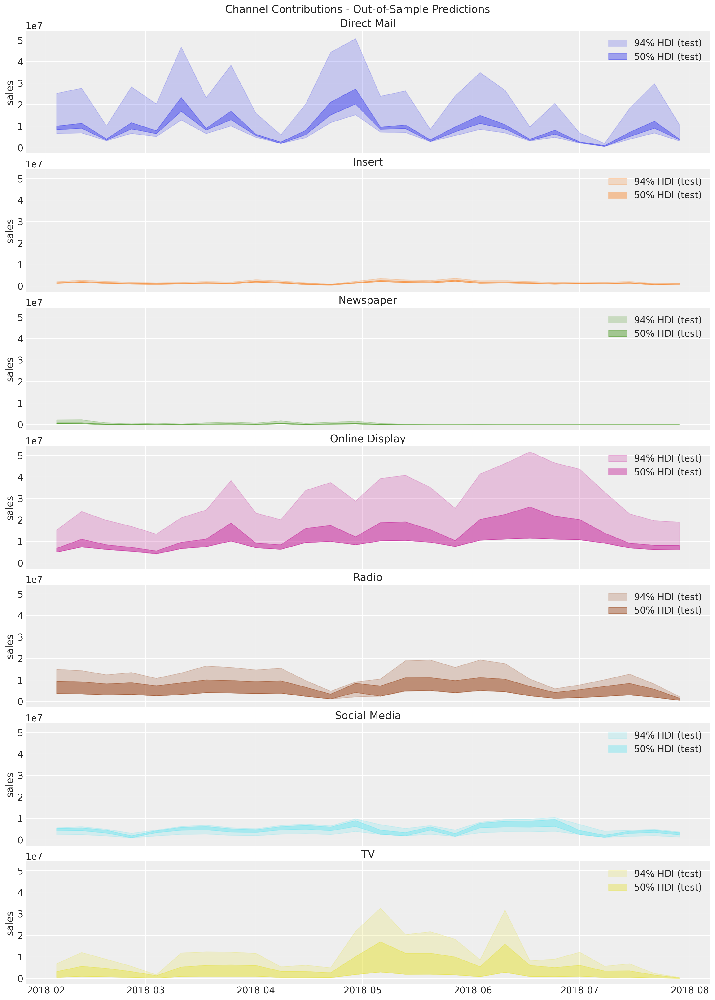

In [ ]:
fig, axes = plt.subplots(
    nrows=len(channel_columns),
    ncols=1,
    figsize=(15, 3 * n_channels),
    sharex=True,
    sharey=True,
    layout="constrained",
)

for i, channel in enumerate(channel_columns):
    for j, hdi_prob in enumerate([0.94, 0.5]):
        ax = axes[i]
        az.plot_hdi(
            X_test[date_column],
            y_pred_test["channel_contributions"]
            .sel(channel=channel)
            .unstack()
            .transpose(..., "date"),
            hdi_prob=hdi_prob,
            color=f"C{i}",
            smooth=False,
            fill_kwargs={"alpha": 0.2 + 0.2 * j, "label": f"{hdi_prob:.0%} HDI (test)"},
            ax=ax,
        )
    ax.legend(loc="upper right")
    ax.set(title=channel, ylabel="sales")

fig.suptitle("Channel Contributions - Out-of-Sample Predictions", fontsize=16);

We do not have the *true* values contributions to compare against because this is what we are trying to estimate on the first place. Nevertheless, we can still do the time slice cross validation at the channel level to analyze the stability of the out-of-sample predictions and media parameters (adstock and saturation).

## Budget Optimization

In this las section we explain how to use PyMC-Marketing to perform optimization of the media budget allocation. The main idea is to use the response curves to optimize the spend. For more details see {ref}`mmm_budget_allocation_example` notebook.

For this example, let us assume we want to re-allocate the budget of the tests set. The PyMC-Marketing MMM optimizer would assume we will equally allocate the budget to all channels over the next `num_periods` periods. Hence, when we specify the `budget` variable we are actually specifying the weekly budget (in this case). Therefore, it is important to understand the past average weekly spend per channel:

In [ ]:
X_test[channel_columns].sum(axis=0)

Direct Mail       12107275.13
Insert             1065383.05
Newspaper           273433.16
Online Display     6498301.30
Radio              3384098.82
Social Media       4298913.23
TV                 2610543.53
dtype: float64

In [ ]:
num_periods = X_test[date_column].shape[0]

# Total budget for the test set per channel
all_budget_per_channel = X_test[channel_columns].sum(axis=0)

# Total budget for the test set
all_budget = all_budget_per_channel.sum()

# Weekly budget for each channel
# We are assuming we do not know the total budget allocation in advance
# so this would be the naive "uniform" allocation.
per_channel_weekly_budget = all_budget / (num_periods * len(channel_columns))

Let's plot the average weekly spend per channel for the *actual* test set.


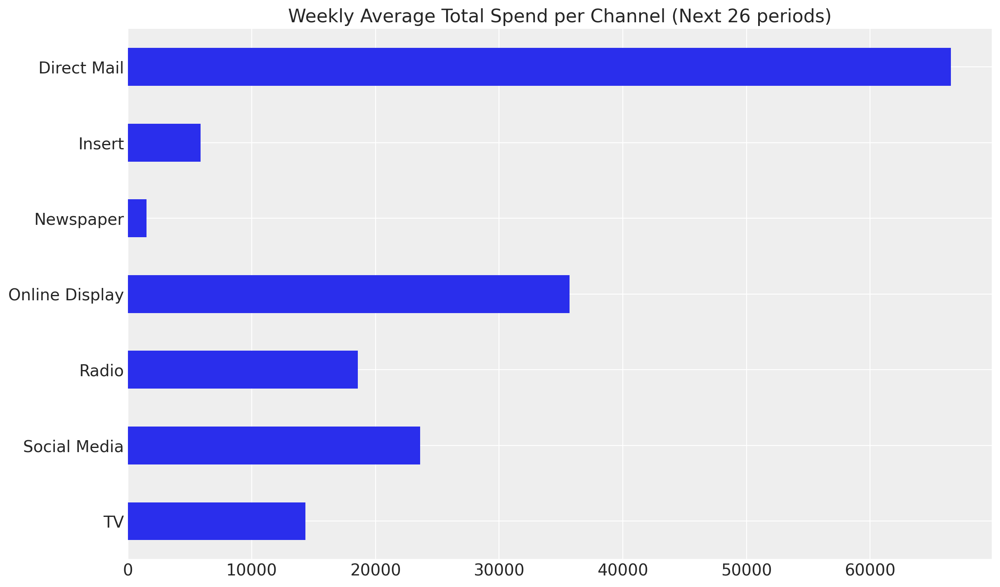

In [ ]:
fig, ax = plt.subplots()
(
    all_budget_per_channel.div(num_periods * len(channel_columns))
    .sort_index(ascending=False)
    .plot.barh(color="C0", ax=ax)
)
ax.set(title=f"Weekly Average Total Spend per Channel (Next {num_periods} periods)");

Observe that the spend distribution on the test set is considerably different from the train set. When planning future spends, this is usually the case as the team might be exploring new investment opportunities. For example that in the test set we have on average more spend on `Online Display` while less spend on `Insert`, both with high ROAS from the training data.

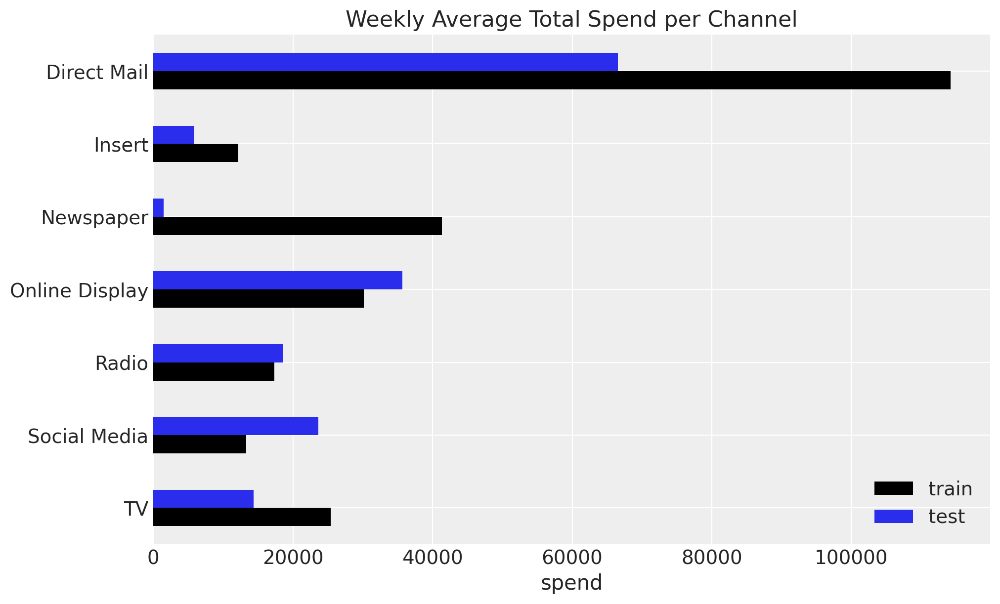

In [ ]:
average_spend_per_channel_train = X_train[channel_columns].sum(axis=0) / (
    X_train.shape[0] * len(channel_columns)
)

average_spend_per_channel_test = X_test[channel_columns].sum(axis=0) / (
    X_test.shape[0] * len(channel_columns)
)

fig, ax = plt.subplots(figsize=(10, 6))
average_spend_per_channel_train.to_frame(name="train").join(
    other=average_spend_per_channel_test.to_frame(name="test"),
    how="inner",
).sort_index(ascending=False).plot.barh(color=["black", "C0"], ax=ax)
ax.set(title="Weekly Average Total Spend per Channel", xlabel="spend");

Next, let's talk about the variability of the allocation. Even if the model finds `Insert` as the most efficient channel, strategically is very hard to simply put $100\%$ of the budget into this channel. A better strategy, which generally plays well with the stakeholders, is to allow a custom degree of flexibility and some upper and lower bounds for each channel budget.

For example, we will allow a $50\%$ difference on the past average weekly spend for each channel.

In [ ]:
percentage_change = 0.5

mean_spend_per_period_test = (
    X_test[channel_columns].sum(axis=0).div(num_periods * len(channel_columns))
)

budget_bounds = {
    key: [(1 - percentage_change) * value, (1 + percentage_change) * value]
    for key, value in (mean_spend_per_period_test).to_dict().items()
}

Now we are ready to pass all this business requirements to the optimizer.

In [ ]:
model_granularity = "weekly"
allocation_strategy, optimization_result = mmm.optimize_budget(
    budget=per_channel_weekly_budget,
    num_periods=num_periods,
    budget_bounds=budget_bounds,
    minimize_kwargs={
        "method": "SLSQP",
        "options": {"ftol": 1e-9, "maxiter": 5_000},
    },
)

response = mmm.sample_response_distribution(
    allocation_strategy=allocation_strategy,
    time_granularity=model_granularity,
    num_periods=num_periods,
    noise_level=0.05,
)

/Users/shua0225/pymc-marketing/pymc-marketing/pymc_marketing/mmm/budget_optimizer.py:215: UserWarning: Using default equality constraint
  self.set_constraints(


Let's visualize the results.

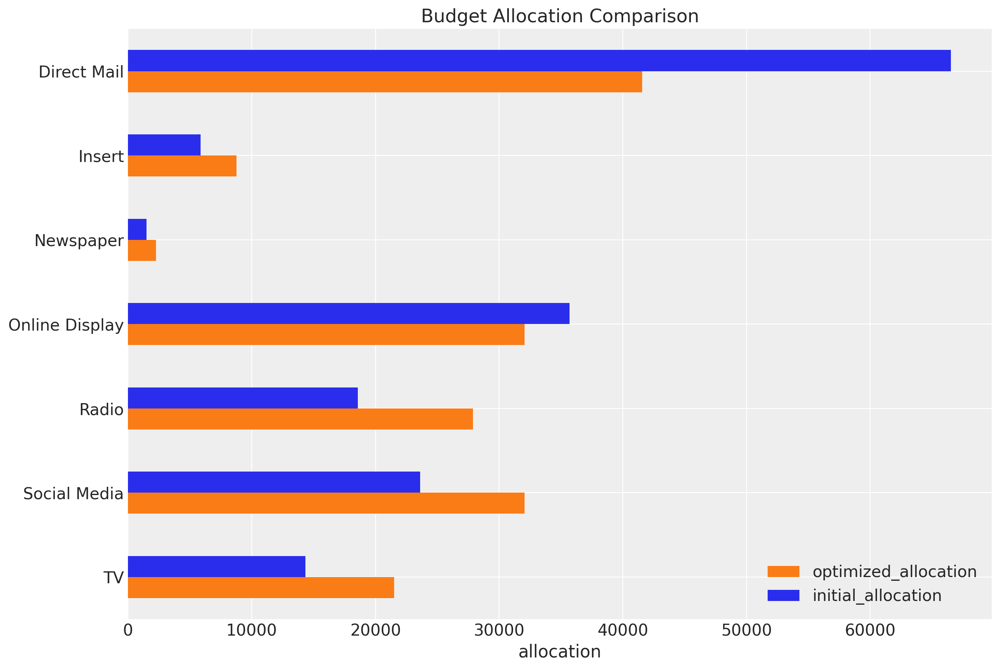

In [ ]:
fig, ax = plt.subplots()

(
    pd.Series(allocation_strategy, index=mean_spend_per_period_test.index)
    .to_frame(name="optimized_allocation")
    .join(mean_spend_per_period_test.to_frame(name="initial_allocation"))
    .sort_index(ascending=False)
    .plot.barh(figsize=(12, 8), color=["C1", "C0"], ax=ax)
)
ax.set(title="Budget Allocation Comparison", xlabel="allocation");

We verify that the sum of the budget allocation is the same as the initial budget.

In [ ]:
np.testing.assert_allclose(
    mean_spend_per_period_test.sum(), allocation_strategy.sum().item()
)

The first thing we notice is how the spend on `Direct Mail` has been reduced. This is consistent with the previous findings that this channel is not very efficient. The spends has been distributed more evenly across the other channels. Interestingly, we see how the spend on `Online Display` is slightly reduced. This might be explained by the fact that this channel already had an average spend increase from the training to the test set.

Next, we can look into the expected channel contributions with this new budget allocation over time.

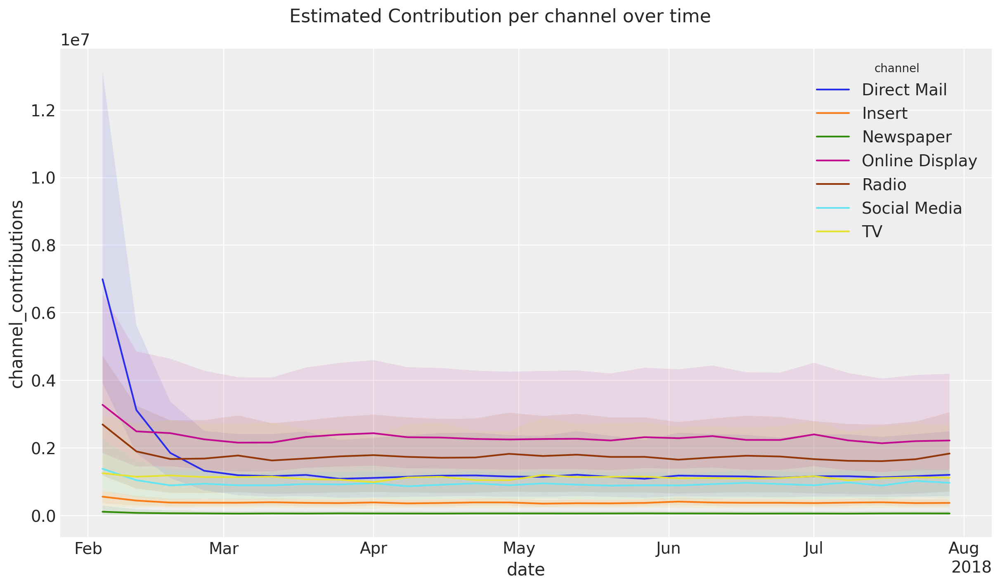

In [ ]:
fig = mmm.plot_allocated_contribution_by_channel(samples=response)
fig.suptitle("Estimated Contribution per channel over time", fontsize=16);

```{note}
Observe that uncertainty increases given the new level of spending. For example, historically spending for `Online Display` was in between $200$K to $250$K and we are now recommending around $350$K. The fact that this spend level has not been reached before is refelected in the increased uncertainty (yellow band).
```

We can also obtain the average expected contributions per channel with the new budget allocation.

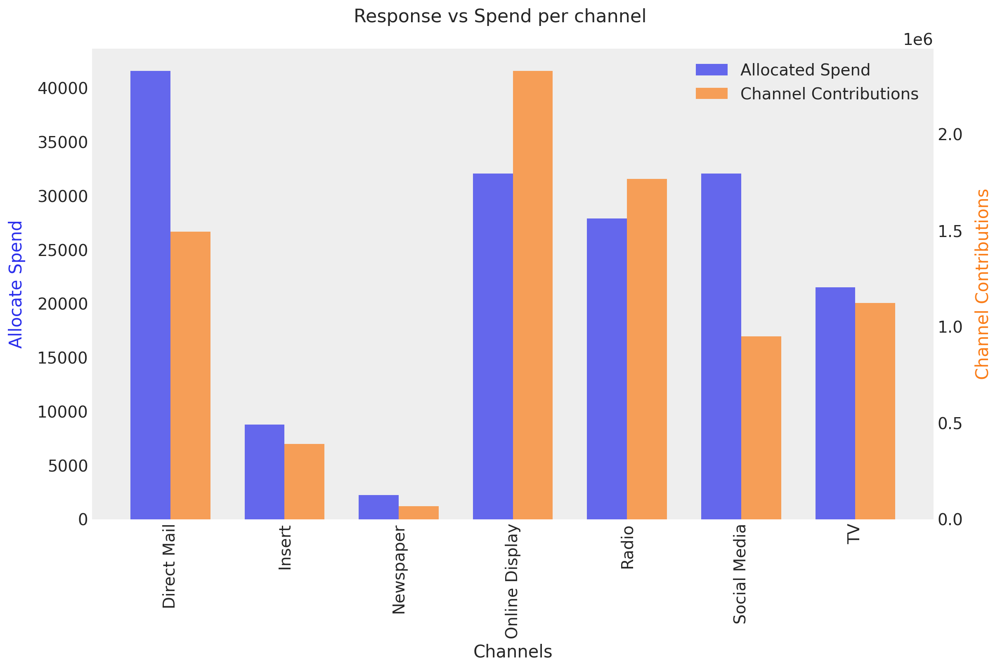

In [ ]:
fig, ax = mmm.plot_budget_allocation(samples=response, figsize=(12, 8))
fig.suptitle("Response vs Spend per channel", fontsize=16);

Lastly, we want to compare the optimized budget allocation with the initial (naive) allocation. We compare this at two levels:

1. Channel contributions: We compute the difference between the optimized and naive channel contributions from the posterior predictive samples.
2. Total Sales: We compute the difference between the optimized and naive total sales from the posterior predictive samples. In this case we include the intercept and seasonality, but we se the control variables to zero as in many cases we do not have them for the future.



### Channel Contribution Comparison

The first thing we need to do is to compute the naive channel contributions for the test period. We do this by simply setting these values as uniform across the test period and then using the model (trained on the training period) to compute the expected channel contributions.

In [ ]:
X_actual_uniform = X_test.copy()

for channel in channel_columns:
    X_actual_uniform[channel] = mean_spend_per_period_test[channel]

for control in control_columns:
    X_actual_uniform[control] = 0.0

pred_test_uniform = mmm.sample_posterior_predictive(
    X_actual_uniform,
    include_last_observations=True,
    original_scale=True,
    var_names=["y", "channel_contributions"],
    extend_idata=False,
    progressbar=False,
    random_seed=rng,
)

Let's visualize the optimized and naive channel contributions.

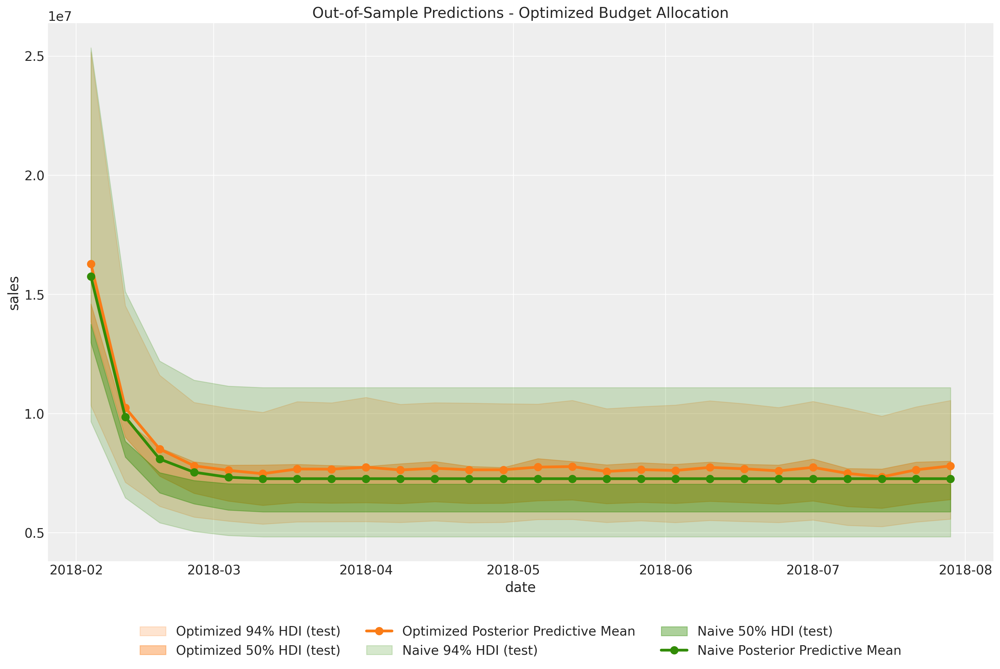

In [ ]:
response_channel_contribution_original_scale = apply_sklearn_transformer_across_dim(
    data=response["channel_contributions"]
    .unstack()
    .sum(dim="channel")
    .transpose(..., "date"),
    func=mmm.get_target_transformer().inverse_transform,
    dim_name="date",
)


fig, ax = plt.subplots(figsize=(15, 10))

az.plot_hdi(
    X_test[date_column],
    response_channel_contribution_original_scale,
    hdi_prob=0.94,
    color="C1",
    fill_kwargs={"alpha": 0.2, "label": f"Optimized {0.94:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    X_test[date_column],
    response_channel_contribution_original_scale,
    hdi_prob=0.5,
    color="C1",
    fill_kwargs={"alpha": 0.4, "label": f"Optimized {0.50:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
ax.plot(
    X_test[date_column],
    response_channel_contribution_original_scale.mean(dim=("chain", "draw")),
    marker="o",
    markersize=8,
    color="C1",
    linewidth=3,
    label="Optimized Posterior Predictive Mean",
)

az.plot_hdi(
    X_actual_uniform[date_column],
    pred_test_uniform["channel_contributions"]
    .unstack()
    .sum(dim="channel")
    .transpose(..., "date"),
    hdi_prob=0.94,
    color="C2",
    fill_kwargs={"alpha": 0.2, "label": f"Naive {0.94:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    X_actual_uniform[date_column],
    pred_test_uniform["channel_contributions"]
    .unstack()
    .sum(dim="channel")
    .transpose(..., "date"),
    hdi_prob=0.5,
    color="C2",
    fill_kwargs={"alpha": 0.4, "label": f"Naive {0.50:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
ax.plot(
    X_actual_uniform[date_column],
    pred_test_uniform["channel_contributions"]
    .unstack()
    .sum(dim="channel")
    .transpose(..., "date")
    .mean(dim=("chain", "draw")),
    marker="o",
    markersize=8,
    color="C2",
    linewidth=3,
    label="Naive Posterior Predictive Mean",
)

ax.legend(loc="lower center", bbox_to_anchor=(0.5, -0.20), ncol=3)

ax.set(
    title="Out-of-Sample Predictions - Optimized Budget Allocation",
    xlabel="date",
    ylabel="sales",
);

We see indeed that the optimized allocation strategy is more efficient regarding the aggregated channel contributions. This is exactly what we were looking for!

We can quantify the percentage improvement of the optimized allocation by comparing the two posterior distributions aggregated over time.

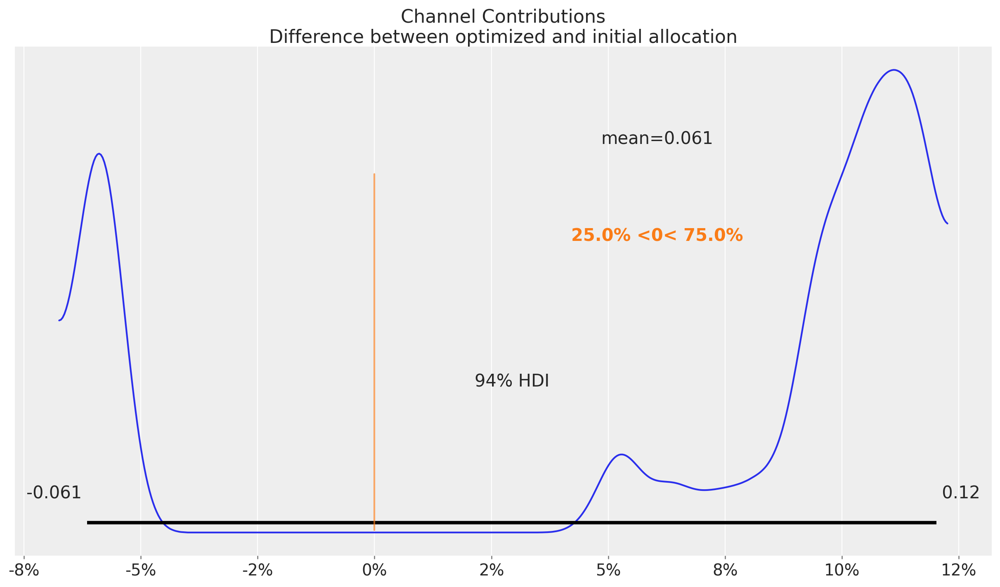

In [ ]:
fig, ax = plt.subplots()
az.plot_posterior(
    (
        response_channel_contribution_original_scale.sum(dim="date")
        - pred_test_uniform["channel_contributions"]
        .unstack()
        .sum(dim="channel")
        .transpose(..., "date")
        .sum(dim="date")
    )
    / response_channel_contribution_original_scale.sum(dim="date"),
    ref_val=0,
    ax=ax,
)
ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{x:.0%}"))
ax.set(
    title="Channel Contributions\nDifference between optimized and initial allocation"
);

Concretely, we see an approximately $10\%$ increase in the aggregated channel contributions. This could result in a significant increase in monetary value!

```{note}
The orange line and corresponding range compares these posterior samples to the reference value of zero. Hence, we have a probability of more than $80\%$ that the optimized allocation will perform better than the initial allocation.
```

### Sales Comparison

Next, we want to compare the optimized and naive total sales. The strategy is the same as in the case above. The only difference is that we add additional variables like seasonality and baseline (intercept). As mentioned above, we set the control variables to zero for the sake of comparison. This is what is done in the {meth}`~pymc_marketing.mmm.mmm.MMM.allocate_budget_to_maximize_response` method.


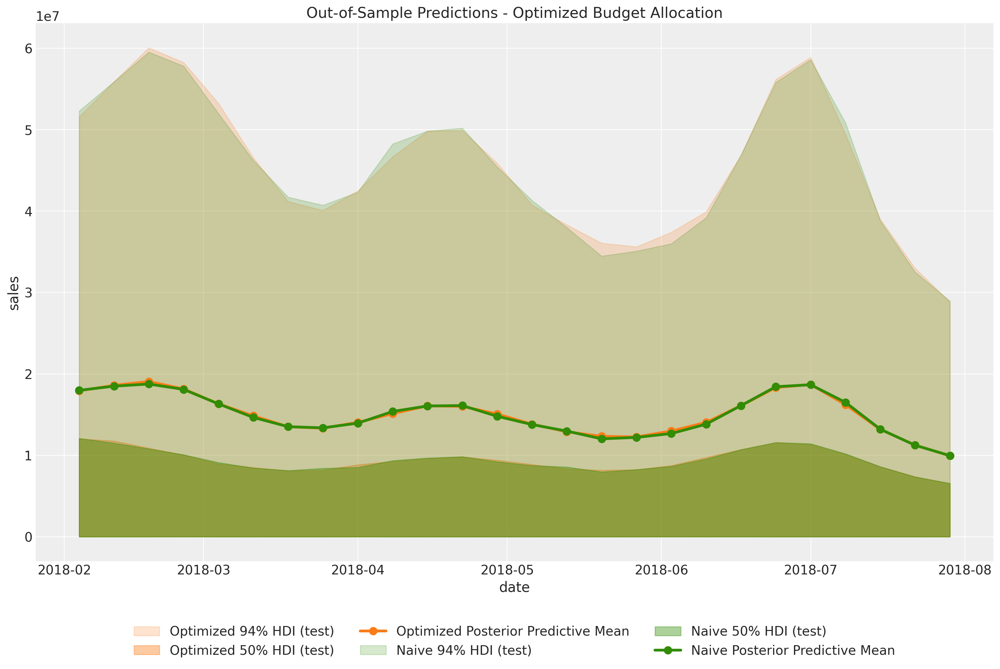

In [ ]:
y_response_original_scale = apply_sklearn_transformer_across_dim(
    data=response["y"].unstack().transpose(..., "date"),
    func=mmm.get_target_transformer().inverse_transform,
    dim_name="date",
)

fig, ax = plt.subplots(figsize=(15, 10))

az.plot_hdi(
    X_test[date_column],
    y_response_original_scale,
    hdi_prob=0.94,
    color="C1",
    fill_kwargs={"alpha": 0.2, "label": f"Optimized {0.94:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    X_test[date_column],
    y_response_original_scale,
    hdi_prob=0.5,
    color="C1",
    fill_kwargs={"alpha": 0.4, "label": f"Optimized {0.50:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
ax.plot(
    X_test[date_column],
    y_response_original_scale.mean(dim=("chain", "draw")),
    marker="o",
    markersize=8,
    color="C1",
    linewidth=3,
    label="Optimized Posterior Predictive Mean",
)

az.plot_hdi(
    X_actual_uniform[date_column],
    pred_test_uniform["y"].unstack().transpose(..., "date"),
    hdi_prob=0.94,
    color="C2",
    fill_kwargs={"alpha": 0.2, "label": f"Naive {0.94:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
az.plot_hdi(
    X_actual_uniform[date_column],
    pred_test_uniform["y"].unstack().transpose(..., "date"),
    hdi_prob=0.5,
    color="C2",
    fill_kwargs={"alpha": 0.4, "label": f"Naive {0.50:.0%} HDI (test)"},
    smooth=False,
    ax=ax,
)
ax.plot(
    X_actual_uniform[date_column],
    pred_test_uniform["y"].unstack().transpose(..., "date").mean(dim=("chain", "draw")),
    marker="o",
    markersize=8,
    color="C2",
    linewidth=3,
    label="Naive Posterior Predictive Mean",
)

ax.legend(loc="lower center", bbox_to_anchor=(0.5, -0.20), ncol=3)

ax.set(
    title="Out-of-Sample Predictions - Optimized Budget Allocation",
    xlabel="date",
    ylabel="sales",
);

At the level of total sales, in this case the difference is negligible as the baseline and seasonality (which are the same in both cases) explain most of the variance as the average weekly media spend in this last period is much smaller as in the training set. 

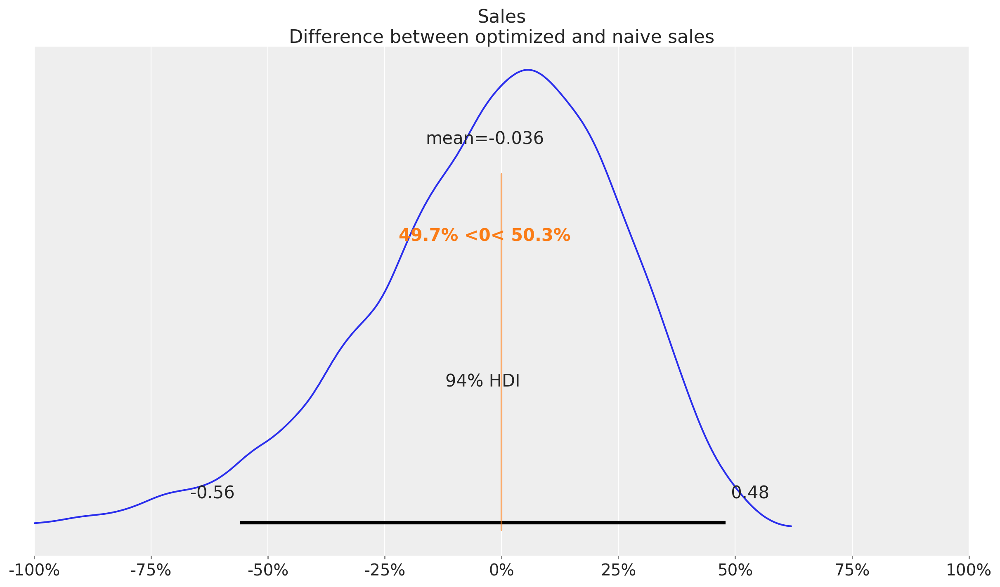

In [ ]:
fig, ax = plt.subplots()
az.plot_posterior(
    (
        y_response_original_scale.sum(dim="date")
        - pred_test_uniform["y"].unstack().sum(dim="date")
    )
    / y_response_original_scale.sum(dim="date"),
    ref_val=0,
    ax=ax,
)
ax.xaxis.set_major_formatter(plt.FuncFormatter(lambda x, _: f"{x:.0%}"))
ax.set(title="Sales\nDifference between optimized and naive sales", xlim=(-1, 1));

In this case we see that when we compare the posterior samples of the uplift to the reference value of zero we do not find any difference. This should not be discouraging as we did see a $10\%$ increase in the aggregated (over time) channel contributions. This can translate to a lot of money! There is no discrepancy on the results. What we are seeing is that the constrained optimization problem where we are just allowed, because of business requirements (which is very common for many marketing teams), to change the budget up to $60\%$ we improved the channel contributions significantly but not at the same order of magnitude of the other model components.

## Conclusion

This case study demonstrated how to leverage PyMC-Marketing's Media Mix Modeling capabilities to gain actionable insights into marketing effectiveness and optimize budget allocation. We walked through the entire process from data preparation and exploratory analysis to model fitting, diagnostics, and budget optimization.
The model provided valuable insights into the effectiveness of different marketing channels, their saturation effects, and return on ad spend. We were able to use these insights to propose an optimized budget allocation that aims to maximize sales while respecting business constraints.

## Next Steps

1. Stakeholder engagement: Present findings to key stakeholders, focusing on actionable insights and potential business impact. Understand their feedback and iterate.

2. Scenario planning: Use the model to simulate various budget scenarios and market conditions to support strategic decision-making.

3. Integration with other tools: Explore ways to integrate the MMM insights with other marketing analytics tools and processes for a more holistic view of marketing performance.

4. Time-slice cross-validation: Implement a more robust validation strategy to ensure model stability and performance over time (see {ref}`mmm_time_slice_cross_validation`). 

5. Iterate and refine: This analysis represents a first iteration. Future iterations could incorporate:

   - Lift test data to better calibrate the model (see {ref}`mmm_lift_test`)
   - More granular data (e.g., daily instead of weekly)
   - Additional variables like competitor actions or macroeconomic factors

1. A/B (or Geo) testing: Design experiments to test the model's recommendations and validate its predictions in the real world.

2. Regular updates: Establish a process for regularly updating the model with new data to keep insights current.

3. Explore advanced features: Investigate other PyMC-Marketing capabilities, such as incorporating time varying parameters (see and {ref}`mmm_tv_intercept` {ref}`(mmm_time_varying_media_example`) and custom models like hierarchical levels or more complex seasonality patterns, to further refine the model (see {ref}`mmm_components`).

In [ ]:
%load_ext watermark
%watermark -n -u -v -iv -w -p pymc_marketing,pytensor,numpyro

Last updated: Thu Apr 24 2025

Python implementation: CPython
Python version       : 3.11.3
IPython version      : 9.1.0

pymc_marketing: 0.13.1
pytensor      : 2.30.3
numpyro       : 0.18.0

typing        : 3.7.4.3
IPython       : 9.1.0
seaborn       : 0.13.2
matplotlib    : 3.10.1
pandas        : 2.2.3
sys           : 3.11.3 (main, Apr  7 2023, 20:13:31) [Clang 14.0.0 (clang-1400.0.29.202)]
pymc_marketing: 0.13.1
numpyro       : 0.18.0
numpy         : 1.26.4
arviz         : 0.21.0

Watermark: 2.5.0

